In [1]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, InsetPosition,
                                                  mark_inset)
import matplotlib.ticker as ticker
from collections import OrderedDict
from scipy import stats
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import pylab as plot
first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)



# Here are my rc parameters for matplotlibf
fsize = 20
mpl.rc('font', serif='Helvetica Neue')
#mpl.rc('font', serif='Times New Roman')
mpl.rcParams.update({'font.size': fsize})
mpl.rcParams['figure.figsize'] = 3.2, 2.8
mpl.rcParams['figure.dpi'] = 500
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 1.5
# Set x tick params
mpl.rcParams['xtick.major.size'] = 4.5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.size'] = 3.
mpl.rcParams['xtick.minor.width'] = 1.25
# Set y tick params
mpl.rcParams['ytick.major.size'] = 4.5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.size'] = 3.
mpl.rcParams['ytick.minor.width'] = 1.25
mpl.rcParams['legend.fontsize']= 20.
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams["font.family"] = "Times New Roman"
# Load LaTeX and amsmath
# mpl.rc('text', usetex=True)
# mpl.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]

In [2]:
# Get the current path
if first:
    parent = os.getcwd()
print(parent)
# Grab file names from data folder

  
# Grab the MCS data
pres = os.listdir('./bubble2/Interpart_press')
try:
    pres.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
    
# Grab the MCS data
pres2 = os.listdir('./bubble2/BubComp')
try:
    pres2.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
# Grab the MCS data
pres3 = os.listdir('./bubble2/PhaseComp')
try:
    pres3.remove('.DS_Store')
except:
    print(".DS_Store not in directory")
  
    
# Grab the MCS data
pres5 = os.listdir('./bubble2/lat_end')
try:
    pres5.remove('.DS_Store')
except:
    print(".DS_Store not in directory")    

# Grab the MCS data
pres6 = os.listdir('./bubble2/PhaseComp_bins')
try:
    pres6.remove('.DS_Store')
except:
    print(".DS_Store not in directory")  
    
# Grab the MCS data
pres7 = os.listdir('./bubble2/bubble3')
try:
    pres7.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres8 = os.listdir('./bubble2/bubble_radial4')
try:
    pres8.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres10 = os.listdir('./bubble2/surface')
try:
    pres10.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres11 = os.listdir('./bubble2/compressibility')
try:
    pres11.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    
# Grab the MCS data
pres12 = os.listdir('./bubble2/surface_radial')
try:
    pres12.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
# Grab the MCS data
pres13 = os.listdir('./bubble2/interpart_press_radial')
try:
    pres13.remove('.DS_Store')
except:
    print(".DS_Store not in directory") 
    

C:\Users\Nick\Desktop\jupyter_analysis_updated
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory
.DS_Store not in directory


In [3]:
# Some functions to get the relevant data from the filenames
def checkFile(fname, string):
    for i in range(len(fname)):
        if fname[i] == string[0]:
#             print"{} matches {}".format(fname[i], string[0])
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
#                     print"{} matches {}".format(fname[i+j], string[j])
                    if j == (len(string) - 1):
#                         print"Final match!"
                        return True
                else:
                    break
    return False
    
def txtValue(fname, string):
    out = ""
    index = 0
    for i in range(len(fname)):
        if fname[i] == string[0]:
            for j in range(1, len(string)):
                if (i + j) > (len(fname) - 1):
                    break
                elif fname[i + j] == string[j]:
                    if j == (len(string) - 1):
                        # Last index of search string
                        index = i + j
                else:
                    break
                        
    # First index of value
    index += 1
    mybool = True
    while mybool:
        if fname[index].isdigit():
            out = out + fname[index]
            index += 1
        elif fname[index] == ".":    
            if fname[index+1].isdigit():
                out = out + fname[index]
                index += 1
            else:
                mybool = False
        else:
            mybool = False
    return float(out)

# Sorting functions
def multiSort(arr1, arr2, arr3, arr4):
    """Sort an array the slow (but certain) way, returns original indices in sorted order"""
    # Doing this for PeR, PeS, xS in this case
    cpy1 = np.copy(arr1)
    cpy2 = np.copy(arr2)
    cpy3 = np.copy(arr3)
    cpy4 = np.copy(arr4)
    ind = np.arange(0, len(arr1))
    for i in range(len(cpy1)):
        for j in range(len(cpy1)):
            # Sort by first variable
            if cpy1[i] > cpy1[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            # If first variable is equal, resort to second variable
            elif cpy1[i] == cpy1[j] and cpy2[i] > cpy2[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
                
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] > cpy3[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
            elif cpy1[i] == cpy1[j] and cpy2[i] == cpy2[j] and cpy3[i] == cpy3[j] and cpy4[i] > cpy4[j] and i < j:
                # Swap copy array values
                cpy1[i], cpy1[j] = cpy1[j], cpy1[i]
                cpy2[i], cpy2[j] = cpy2[j], cpy2[i]
                cpy3[i], cpy3[j] = cpy3[j], cpy3[i]
                cpy4[i], cpy4[j] = cpy4[j], cpy4[i]
                # Swap the corresponding indices
                ind[i], ind[j] = ind[j], ind[i]
    return ind

def indSort(arr1, arr2):
    """Take sorted index array, use to sort array"""
    # arr1 is array to sort
    # arr2 is index array
    cpy = np.copy(arr1)
    for i in range(len(arr1)):
        arr1[i] = cpy[arr2[i]]

In [4]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres = []
os.chdir(parent)
os.chdir('./bubble2/Interpart_press')
for i in pres:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres[-1])

,tauB,sizeBin_x,sizeBin_y,clust_size,all-all_bulk_press,all-all_bulk_shear,all-all_int_press,all-all_int_shear,all-all_gas_press,all-all_gas_shear,all-all_dense_press,all-all_dense_shear,all-all_system_press,all-all_system_shear,all-A_bulk_press,all-A_bulk_shear,all-A_int_press,all-A_int_shear,all-A_gas_press,all-A_gas_shear,all-A_dense_press,all-A_dense_shear,all-A_system_press,all-A_system_shear,all-B_bulk_press,all-B_bulk_shear,all-B_int_press,all-B_int_shear,all-B_gas_press,all-B_gas_shear,all-B_dense_press,all-B_dense_shear,all-B_system_press,all-B_system_shear,A-A_bulk_press,A-A_bulk_shear,A-A_int_press,A-A_int_shear,A-A_gas_press,A-A_gas_shear,A-A_dense_press,A-A_dense_shear,A-A_system_press,A-A_system_shear,A-B_bulk_press,A-B_bulk_shear,A-B_int_press,A-B_int_shear,A-B_gas_press,A-B_gas_shear,A-B_dense_press,A-B_dense_shear,A-B_system_press,A-B_system_shear,B-B_bulk_press,B-B_bulk_shear,B-B_int_press,B-B_int_shear,B-B_gas_press,B-B_gas_shear,B-B_dense_press,B-B_dense_shear,B-B_system_press,B-B_system_shear
0,40.0,5.025009,5.025009,74258,5404.586298,60.373967,2397.939432,-12.360186,13.189564,0.000922,3964.577783,25.538549,1424.835201,9.124318,2000.747764,22.801355,1025.616727,-6.374067,8.520886,-0.045608,1533.716862,8.828029,553.401856,3.124526,3403.838535,37.572612,1372.322705,-5.986119,4.668678,0.046530,2430.860921,16.710520,871.433345,5.999792,756.690687,7.854289,466.174034,-4.174312,5.120638,-0.046864,617.550152,2.093290,223.912972,0.717713,1244.813890,14.584191,558.623318,-1.788728,3.399186,-0.003068,916.168622,6.742517,329.488884,2.406813,2159.024644,22.988421,813.699387,-4.197391,1.269492,0.049598,1514.692299,9.968003,541.944461,3.592979
1,40.1,5.025009,5.025009,74296,5382.993296,25.666220,2385.941548,-3.575308,13.629063,0.087174,4001.757625,12.189829,1419.167427,4.352520,2001.333380,9.937396,1012.643974,-3.436899,8.858113,0.040842,1545.681229,3.773654,550.481538,1.356399,3381.659916,15.728824,1373.297575,-0.138409,4.770949,0.046333,2456.076396,8.416175,868.685890,2.996121,763.213432,5.383184,460.367526,-4.102748,5.315619,0.017552,623.642412,1.011452,223.232874,0.367833,1240.276465,4.543389,549.733407,0.668960,3.547579,0.025684,922.029472,2.757801,327.248663,0.988566,2141.383451,11.185435,823.564168,-0.807369,1.223370,0.020649,1534.046923,5.658374,541.437227,2.007555
2,40.2,5.025009,5.025009,74245,5326.408506,0.368592,2418.535574,10.008299,13.422395,-0.098681,3956.966155,4.908344,1400.965569,1.663050,1983.233093,1.436171,1022.345210,5.160984,8.557819,-0.074547,1530.709688,3.190346,544.129773,1.074211,3343.175412,-1.067580,1396.190364,4.847315,4.864576,-0.024134,2426.256467,1.717999,856.835797,0.588839,757.619459,1.405751,458.502073,0.604358,5.041103,-0.081732,616.752225,1.028341,220.272794,0.308849,1226.600663,0.148081,562.766143,4.406334,3.508577,0.011815,913.972454,2.153475,323.856978,0.765362,2116.574750,-1.215660,833.424222,0.440981,1.355999,-0.035948,1512.284013,-0.435477,532.978819,-0.176523
3,40.3,5.025009,5.025009,74007,5296.836093,25.967179,2381.249613,15.478205,13.846546,0.074221,3909.517377,20.976228,1397.320697,7.497175,1977.740269,6.960082,998.629984,5.820078,8.898878,0.038677,1511.851834,6.417635,542.644324,2.304044,3319.095824,19.007097,1382.619629,9.658127,4.947669,0.035544,2397.665543,14.558592,854.676374,5.193131,755.036161,3.099012,448.875818,-0.729664,5.246906,0.013700,609.356389,1.277220,219.785016,0.462415,1221.715046,3.674134,550.804838,6.750117,3.662158,0.026433,902.476946,5.137774,322.859308,1.841629,2097.380778,15.332962,831.814791,2.908011,1.285510,0.009111,1495.188597,9.420818,531.817066,3.351502
4,40.4,5.025009,5.025009,73980,5335.783524,-11.266871,2533.235820,20.427883,14.421575,-0.001047,3993.347690,3.915091,1403.668540,1.366277,1976.198742,-3.782011,1077.396398,7.053736,9.353478,-0.000904,1545.667454,1.408372,545.759399,0.491147,3359.584781,-7.484860,1455.839422,13.374147,5.068097,-0.000144,2447.680236,2.506719,857.909141,0.875131,750.441798,1.964638,488.090129,3.491876,5.600354,0.0

In [5]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params2 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params2 = params2.append(df, ignore_index = True)
display(params2)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\4098459835.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params2 = params2.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [6]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres)):
    # Ger rid of NaN in favor of 0
    all_pres[i].fillna(0, inplace=True)

headers=list(all_pres[0])
display(all_pres[0])
print(all_pres[0][headers[1]][0])
print(all_pres[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,all-all_bulk_press,all-all_bulk_shear,all-all_int_press,all-all_int_shear,all-all_gas_press,all-all_gas_shear,all-all_dense_press,all-all_dense_shear,all-all_system_press,all-all_system_shear,all-A_bulk_press,all-A_bulk_shear,all-A_int_press,all-A_int_shear,all-A_gas_press,all-A_gas_shear,all-A_dense_press,all-A_dense_shear,all-A_system_press,all-A_system_shear,all-B_bulk_press,all-B_bulk_shear,all-B_int_press,all-B_int_shear,all-B_gas_press,all-B_gas_shear,all-B_dense_press,all-B_dense_shear,all-B_system_press,all-B_system_shear,A-A_bulk_press,A-A_bulk_shear,A-A_int_press,A-A_int_shear,A-A_gas_press,A-A_gas_shear,A-A_dense_press,A-A_dense_shear,A-A_system_press,A-A_system_shear,A-B_bulk_press,A-B_bulk_shear,A-B_int_press,A-B_int_shear,A-B_gas_press,A-B_gas_shear,A-B_dense_press,A-B_dense_shear,A-B_system_press,A-B_system_shear,B-B_bulk_press,B-B_bulk_shear,B-B_int_press,B-B_int_shear,B-B_gas_press,B-B_gas_shear,B-B_dense_press,B-B_dense_shear,B-B_system_press,B-B_system_shear
0,40.0,5.025009,5.025009,74258,5404.586298,60.373967,2397.939432,-12.360186,13.189564,0.000922,3964.577783,25.538549,1424.835201,9.124318,2000.747764,22.801355,1025.616727,-6.374067,8.520886,-0.045608,1533.716862,8.828029,553.401856,3.124526,3403.838535,37.572612,1372.322705,-5.986119,4.668678,0.046530,2430.860921,16.710520,871.433345,5.999792,756.690687,7.854289,466.174034,-4.174312,5.120638,-0.046864,617.550152,2.093290,223.912972,0.717713,1244.813890,14.584191,558.623318,-1.788728,3.399186,-0.003068,916.168622,6.742517,329.488884,2.406813,2159.024644,22.988421,813.699387,-4.197391,1.269492,0.049598,1514.692299,9.968003,541.944461,3.592979
1,40.1,5.025009,5.025009,74296,5382.993296,25.666220,2385.941548,-3.575308,13.629063,0.087174,4001.757625,12.189829,1419.167427,4.352520,2001.333380,9.937396,1012.643974,-3.436899,8.858113,0.040842,1545.681229,3.773654,550.481538,1.356399,3381.659916,15.728824,1373.297575,-0.138409,4.770949,0.046333,2456.076396,8.416175,868.685890,2.996121,763.213432,5.383184,460.367526,-4.102748,5.315619,0.017552,623.642412,1.011452,223.232874,0.367833,1240.276465,4.543389,549.733407,0.668960,3.547579,0.025684,922.029472,2.757801,327.248663,0.988566,2141.383451,11.185435,823.564168,-0.807369,1.223370,0.020649,1534.046923,5.658374,541.437227,2.007555
2,40.2,5.025009,5.025009,74245,5326.408506,0.368592,2418.535574,10.008299,13.422395,-0.098681,3956.966155,4.908344,1400.965569,1.663050,1983.233093,1.436171,1022.345210,5.160984,8.557819,-0.074547,1530.709688,3.190346,544.129773,1.074211,3343.175412,-1.067580,1396.190364,4.847315,4.864576,-0.024134,2426.256467,1.717999,856.835797,0.588839,757.619459,1.405751,458.502073,0.604358,5.041103,-0.081732,616.752225,1.028341,220.272794,0.308849,1226.600663,0.148081,562.766143,4.406334,3.508577,0.011815,913.972454,2.153475,323.856978,0.765362,2116.574750,-1.215660,833.424222,0.440981,1.355999,-0.035948,1512.284013,-0.435477,532.978819,-0.176523
3,40.3,5.025009,5.025009,74007,5296.836093,25.967179,2381.249613,15.478205,13.846546,0.074221,3909.517377,20.976228,1397.320697,7.497175,1977.740269,6.960082,998.629984,5.820078,8.898878,0.038677,1511.851834,6.417635,542.644324,2.304044,3319.095824,19.007097,1382.619629,9.658127,4.947669,0.035544,2397.665543,14.558592,854.676374,5.193131,755.036161,3.099012,448.875818,-0.729664,5.246906,0.013700,609.356389,1.277220,219.785016,0.462415,1221.715046,3.674134,550.804838,6.750117,3.662158,0.026433,902.476946,5.137774,322.859308,1.841629,2097.380778,15.332962,831.814791,2.908011,1.285510,0.009111,1495.188597,9.420818,531.817066,3.351502
4,40.4,5.025009,5.025009,73980,5335.783524,-11.266871,2533.235820,20.427883,14.421575,-0.001047,3993.347690,3.915091,1403.668540,1.366277,1976.198742,-3.782011,1077.396398,7.053736,9.353478,-0.000904,1545.667454,1.408372,545.759399,0.491147,3359.584781,-7.484860,1455.839422,13.374147,5.068097,-0.000144,2447.680236,2.506719,857.909141,0.875131,750.441798,1.964638,488.090129,3.491876,5.600354,0.0

5.025009
5.025009


In [7]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres2:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres2, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new = []
os.chdir(parent)
os.chdir('./bubble2/BubComp')
for i in pres2:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,bub_id,Na,Nb,Nbin,int_mean_rad,int_std_rad,int_sa,ext_mean_rad,ext_std_rad,ext_sa,width
0,40.0,5.025009,5.025009,74258,1,1,14457,14941,887,91.417236,20.650163,686.225124,122.731773,19.955470,904.906812,0.000000
1,40.1,5.025009,5.025009,74296,1,1,13899,14407,842,91.815295,20.933796,693.969283,122.137175,19.632131,864.812844,0.000000
2,40.2,5.025009,5.025009,74245,1,1,14300,14985,859,4.888247,0.409145,31.666814,121.689104,20.729501,881.828699,116.800857
3,40.3,5.025009,5.025009,74007,1,1,14350,14917,876,91.352935,20.872742,680.818942,122.768824,20.258719,875.910463,31.415888
4,40.4,5.025009,5.025009,73980,1,1,14487,15390,867,89.981262,20.183713,677.423350,121.509605,19.704398,859.837888,31.528343
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,54.7,5.025009,5.025009,43828,2,2,12405,14358,815,57.647988,15.215992,443.151144,100.530511,29.627241,809.476360,42.882523
212,54.8,5.025009,5.025009,43809,2,1,9013,10624,607,35.458719,20.422399,300.886392,83.780651,23.411140,647.383237,48.321932
213,54.8,5.025009,5.025009,43809,2,2,12494,14494,817,57.936745,15.662846,442.704322,100.739631,30.783498,820.235181,0.000000
214,54.9,5.025009,5.025009,43683,2,1,8941,10564,594,55.552507,19.709960,433.956374,81.693098,22.534946,638.294277,0.000000


[[0.0], [150.0], [500.0], [50.0], [1.0], [60.0], [0], [1e-06]]


In [8]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params3 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params3 = params3.append(df, ignore_index = True)
display(params3)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\2981078307.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params3 = params3.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [9]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new)):
    # Ger rid of NaN in favor of 0
    all_pres_new[i].fillna(0, inplace=True)

headers=list(all_pres_new[0])
display(all_pres_new[0])
print(all_pres_new[0][headers[1]][0])
print(all_pres_new[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,bub_id,Na,Nb,Nbin,int_mean_rad,int_std_rad,int_sa,ext_mean_rad,ext_std_rad,ext_sa,width
0,40.0,5.025009,5.025009,74258,1,1,14457,14941,887,91.417236,20.650163,686.225124,122.731773,19.955470,904.906812,0.000000
1,40.1,5.025009,5.025009,74296,1,1,13899,14407,842,91.815295,20.933796,693.969283,122.137175,19.632131,864.812844,0.000000
2,40.2,5.025009,5.025009,74245,1,1,14300,14985,859,4.888247,0.409145,31.666814,121.689104,20.729501,881.828699,116.800857
3,40.3,5.025009,5.025009,74007,1,1,14350,14917,876,91.352935,20.872742,680.818942,122.768824,20.258719,875.910463,31.415888
4,40.4,5.025009,5.025009,73980,1,1,14487,15390,867,89.981262,20.183713,677.423350,121.509605,19.704398,859.837888,31.528343
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,54.7,5.025009,5.025009,43828,2,2,12405,14358,815,57.647988,15.215992,443.151144,100.530511,29.627241,809.476360,42.882523
212,54.8,5.025009,5.025009,43809,2,1,9013,10624,607,35.458719,20.422399,300.886392,83.780651,23.411140,647.383237,48.321932
213,54.8,5.025009,5.025009,43809,2,2,12494,14494,817,57.936745,15.662846,442.704322,100.739631,30.783498,820.235181,0.000000
214,54.9,5.025009,5.025009,43683,2,1,8941,10564,594,55.552507,19.709960,433.956374,81.693098,22.534946,638.294277,0.000000


5.025009
5.025009


In [10]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres3:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres3, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new2 = []
os.chdir(parent)
os.chdir('./bubble2/PhaseComp')
for i in pres3:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new2.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new2[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all,bulk_A,bulk_B,largest_bulk_all,largest_bulk_A,largest_bulk_B,int_all,int_A,int_B,largest_int_all,largest_int_A,largest_int_B,gas_all,gas_A,gas_B
0,40.0,5.025009,5.025009,74258,46554,17317,29237,46554,17317,29237,29398,14457,14941,29398,14457,14941,24048,18226,5822
1,40.1,5.025009,5.025009,74296,47472,17730,29742,47472,17730,29742,28306,13899,14407,28306,13899,14407,24222,18371,5851
2,40.2,5.025009,5.025009,74245,46494,17339,29155,176,76,100,29285,14300,14985,29285,14300,14985,24221,18361,5860
3,40.3,5.025009,5.025009,74007,46434,17347,29087,46434,17347,29087,29267,14350,14917,29267,14350,14917,24299,18303,5996
4,40.4,5.025009,5.025009,73980,45436,16891,28545,45436,16891,28545,29877,14487,15390,29877,14487,15390,24687,18622,6065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,28771,10792,17979,291,111,180,48275,22281,25994,20351,9396,10955,22954,16927,6027
146,54.6,5.025009,5.025009,43646,30585,11550,19035,713,288,425,46189,21228,24961,20011,9163,10848,23226,17222,6004
147,54.7,5.025009,5.025009,43828,30487,11540,18947,613,208,405,46782,21613,25169,20019,9208,10811,22731,16847,5884
148,54.8,5.025009,5.025009,43809,30568,11593,18975,287,93,194,46625,21507,25118,19637,9013,10624,22807,16900,5907


[[0.0], [150.0], [500.0], [50.0], [1.0], [60.0], [0], [1e-06]]


In [11]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params4 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new2)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params4 = params4.append(df, ignore_index = True)
display(params4)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\1579700554.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params4 = params4.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [12]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new2)):
    # Ger rid of NaN in favor of 0
    all_pres_new2[i].fillna(0, inplace=True)

headers=list(all_pres_new2[0])
display(all_pres_new2[0])
print(all_pres_new2[0][headers[1]][0])
print(all_pres_new2[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all,bulk_A,bulk_B,largest_bulk_all,largest_bulk_A,largest_bulk_B,int_all,int_A,int_B,largest_int_all,largest_int_A,largest_int_B,gas_all,gas_A,gas_B
0,40.0,5.025009,5.025009,74258,46554,17317,29237,46554,17317,29237,29398,14457,14941,29398,14457,14941,24048,18226,5822
1,40.1,5.025009,5.025009,74296,47472,17730,29742,47472,17730,29742,28306,13899,14407,28306,13899,14407,24222,18371,5851
2,40.2,5.025009,5.025009,74245,46494,17339,29155,176,76,100,29285,14300,14985,29285,14300,14985,24221,18361,5860
3,40.3,5.025009,5.025009,74007,46434,17347,29087,46434,17347,29087,29267,14350,14917,29267,14350,14917,24299,18303,5996
4,40.4,5.025009,5.025009,73980,45436,16891,28545,45436,16891,28545,29877,14487,15390,29877,14487,15390,24687,18622,6065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,28771,10792,17979,291,111,180,48275,22281,25994,20351,9396,10955,22954,16927,6027
146,54.6,5.025009,5.025009,43646,30585,11550,19035,713,288,425,46189,21228,24961,20011,9163,10848,23226,17222,6004
147,54.7,5.025009,5.025009,43828,30487,11540,18947,613,208,405,46782,21613,25169,20019,9208,10811,22731,16847,5884
148,54.8,5.025009,5.025009,43809,30568,11593,18975,287,93,194,46625,21507,25118,19637,9013,10624,22807,16900,5907


5.025009
5.025009


In [13]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres5:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres5, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new4 = []
os.chdir(parent)
os.chdir('./bubble2/lat_end')
for i in pres5:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new4.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new4[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all_mean,bulk_all_std,bulk_A_mean,bulk_A_std,bulk_B_mean,bulk_B_std,int_all_mean,int_all_std,int_A_mean,int_A_std,int_B_mean,int_B_std,dense_all_mean,dense_all_std,dense_A_mean,dense_A_std,dense_B_mean,dense_B_std
0,40.0,5.025009,5.025009,74258,0.778923,0.033800,0.778884,0.032583,0.778947,0.034500,0.892085,0.286603,0.941344,0.345120,0.844422,0.204335,0.822724,0.188499,0.852802,0.247623,0.801091,0.125968
1,40.1,5.025009,5.025009,74296,0.779160,0.033812,0.779101,0.032718,0.779196,0.034448,0.890609,0.275987,0.937869,0.333754,0.845014,0.194820,0.820791,0.179094,0.848870,0.236134,0.800674,0.118901
2,40.2,5.025009,5.025009,74245,0.779521,0.032931,0.779454,0.032599,0.779561,0.033127,0.888762,0.264396,0.933397,0.312983,0.846168,0.198542,0.821738,0.174671,0.849032,0.225226,0.802173,0.122890
3,40.3,5.025009,5.025009,74007,0.779789,0.032945,0.779552,0.032168,0.779931,0.033399,0.892878,0.279446,0.945198,0.339410,0.842548,0.192937,0.823511,0.184090,0.854543,0.243963,0.801157,0.119310
4,40.4,5.025009,5.025009,73980,0.779307,0.032383,0.779151,0.031007,0.779399,0.033170,0.881850,0.261965,0.924442,0.313516,0.841757,0.193352,0.819986,0.174280,0.846231,0.226152,0.801243,0.121225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,0.774527,0.030843,0.774372,0.029464,0.774620,0.031641,0.891651,0.299126,0.948894,0.366732,0.842585,0.213716,0.847914,0.244190,0.891946,0.312387,0.814796,0.168895
146,54.6,5.025009,5.025009,43646,0.775861,0.031117,0.775912,0.030223,0.775829,0.031647,0.886415,0.278918,0.940727,0.346416,0.840225,0.193021,0.842373,0.223872,0.882651,0.290239,0.812364,0.150296
147,54.7,5.025009,5.025009,43828,0.777082,0.032566,0.776897,0.031411,0.777194,0.033249,0.896272,0.298099,0.953763,0.364262,0.846904,0.214372,0.849245,0.240028,0.892199,0.306501,0.816965,0.166985
148,54.8,5.025009,5.025009,43809,0.777060,0.032147,0.776976,0.031255,0.777111,0.032679,0.896425,0.293018,0.953433,0.359271,0.847613,0.209022,0.849157,0.235959,0.891630,0.302152,0.817273,0.162993


[[0.0], [150.0], [500.0], [50.0], [1.0], [60.0], [0], [1e-06]]


In [14]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params6 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new4)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params6 = params6.append(df, ignore_index = True)
display(params6)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\186775601.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params6 = params6.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [15]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new4)):
    # Ger rid of NaN in favor of 0
    all_pres_new4[i].fillna(0, inplace=True)

headers=list(all_pres_new4[0])
display(all_pres_new4[0])
print(all_pres_new4[0][headers[1]][0])
print(all_pres_new4[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk_all_mean,bulk_all_std,bulk_A_mean,bulk_A_std,bulk_B_mean,bulk_B_std,int_all_mean,int_all_std,int_A_mean,int_A_std,int_B_mean,int_B_std,dense_all_mean,dense_all_std,dense_A_mean,dense_A_std,dense_B_mean,dense_B_std
0,40.0,5.025009,5.025009,74258,0.778923,0.033800,0.778884,0.032583,0.778947,0.034500,0.892085,0.286603,0.941344,0.345120,0.844422,0.204335,0.822724,0.188499,0.852802,0.247623,0.801091,0.125968
1,40.1,5.025009,5.025009,74296,0.779160,0.033812,0.779101,0.032718,0.779196,0.034448,0.890609,0.275987,0.937869,0.333754,0.845014,0.194820,0.820791,0.179094,0.848870,0.236134,0.800674,0.118901
2,40.2,5.025009,5.025009,74245,0.779521,0.032931,0.779454,0.032599,0.779561,0.033127,0.888762,0.264396,0.933397,0.312983,0.846168,0.198542,0.821738,0.174671,0.849032,0.225226,0.802173,0.122890
3,40.3,5.025009,5.025009,74007,0.779789,0.032945,0.779552,0.032168,0.779931,0.033399,0.892878,0.279446,0.945198,0.339410,0.842548,0.192937,0.823511,0.184090,0.854543,0.243963,0.801157,0.119310
4,40.4,5.025009,5.025009,73980,0.779307,0.032383,0.779151,0.031007,0.779399,0.033170,0.881850,0.261965,0.924442,0.313516,0.841757,0.193352,0.819986,0.174280,0.846231,0.226152,0.801243,0.121225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,0.774527,0.030843,0.774372,0.029464,0.774620,0.031641,0.891651,0.299126,0.948894,0.366732,0.842585,0.213716,0.847914,0.244190,0.891946,0.312387,0.814796,0.168895
146,54.6,5.025009,5.025009,43646,0.775861,0.031117,0.775912,0.030223,0.775829,0.031647,0.886415,0.278918,0.940727,0.346416,0.840225,0.193021,0.842373,0.223872,0.882651,0.290239,0.812364,0.150296
147,54.7,5.025009,5.025009,43828,0.777082,0.032566,0.776897,0.031411,0.777194,0.033249,0.896272,0.298099,0.953763,0.364262,0.846904,0.214372,0.849245,0.240028,0.892199,0.306501,0.816965,0.166985
148,54.8,5.025009,5.025009,43809,0.777060,0.032147,0.776976,0.031255,0.777111,0.032679,0.896425,0.293018,0.953433,0.359271,0.847613,0.209022,0.849157,0.235959,0.891630,0.302152,0.817273,0.162993


5.025009
5.025009


In [16]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres6:
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 

# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres6, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new5 = []
os.chdir(parent)
os.chdir('./bubble2/PhaseComp_bins')
for i in pres6:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0)
    all_pres_new5.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new5[-1])
print(storeVals)

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk,largest_int,gas,int
0,40.0,5.025009,5.025009,74258,965,887,3332,887
1,40.1,5.025009,5.025009,74296,985,842,3357,842
2,40.2,5.025009,5.025009,74245,965,859,3360,859
3,40.3,5.025009,5.025009,74007,965,876,3343,876
4,40.4,5.025009,5.025009,73980,943,867,3374,867
...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,590,616,3125,1469
146,54.6,5.025009,5.025009,43646,629,591,3182,1373
147,54.7,5.025009,5.025009,43828,629,615,3125,1430
148,54.8,5.025009,5.025009,43809,631,607,3129,1424


[[0.0], [150.0], [500.0], [50.0], [1.0], [60.0], [0], [1e-06]]


In [17]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params7 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new5)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params7 = params7.append(df, ignore_index = True)
display(params7)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\723331177.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params7 = params7.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [18]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new5)):
    # Ger rid of NaN in favor of 0
    all_pres_new5[i].fillna(0, inplace=True)

headers=list(all_pres_new5[0])
display(all_pres_new5[0])
print(all_pres_new5[0][headers[1]][0])
print(all_pres_new5[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,bulk,largest_int,gas,int
0,40.0,5.025009,5.025009,74258,965,887,3332,887
1,40.1,5.025009,5.025009,74296,985,842,3357,842
2,40.2,5.025009,5.025009,74245,965,859,3360,859
3,40.3,5.025009,5.025009,74007,965,876,3343,876
4,40.4,5.025009,5.025009,73980,943,867,3374,867
...,...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,590,616,3125,1469
146,54.6,5.025009,5.025009,43646,629,591,3182,1373
147,54.7,5.025009,5.025009,43828,629,615,3125,1430
148,54.8,5.025009,5.025009,43809,631,607,3129,1424


5.025009
5.025009


In [19]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres7:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres7, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new6 = []
os.chdir(parent)
os.chdir('./bubble2/bubble3')
for i in pres7:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new6.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new6[0])

bubble_com_active_pressure_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,current_id,com_x,com_y,tot_fa,tot_faA,tot_faB,avg_fa,avg_faA,avg_faB,avg_align,avg_alignA,avg_alignB,avg_num_dens,avg_num_densA,avg_num_densB,area,num,numA,numB
0,2.8,5.025009,5.025009,11041,1,1,13.146004,90.784273,171.081559,20.305970,150.775589,2.647211,0.607795,4.812239,0.005034,0.004052,0.009624,0.365076,0.181441,0.183635,100731.442995,32357,16023,16334
1,3.1,5.025009,5.025009,10315,1,1,84.571516,346.294206,175.090235,41.800762,133.289473,4.550856,1.024198,5.770053,0.011465,0.006828,0.011540,0.381627,0.191712,0.189915,100699.974253,32955,16557,16398
2,6.6,5.025009,5.025009,18033,1,1,7.144872,60.312606,-1.486406,-32.684050,31.197644,-1.795481,-1.370862,-4.118870,-0.006729,-0.009139,-0.008238,0.322051,0.159869,0.162183,100699.974253,28026,14068,13958
3,7.8,5.025009,5.025009,10732,1,1,353.686174,144.739781,107.751357,9.401675,98.349681,1.366065,-0.079135,4.002598,0.002609,-0.000528,0.008005,0.403913,0.203228,0.200685,100731.442995,38268,19096,19172
4,10.1,5.025009,5.025009,10317,1,1,19.955391,352.595468,88.486565,33.234484,55.252081,4.185483,1.870517,5.751468,0.011899,0.012470,0.011503,0.201673,0.100869,0.100805,100731.442995,18759,9419,9340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1501,99.6,5.025009,5.025009,60678,2,2,182.403633,183.359235,3211.030223,675.899470,2535.130753,38.304039,15.830609,59.362891,0.111426,0.105537,0.118726,0.269616,0.122065,0.147551,55605.267033,26048,12145,13903
1502,99.7,5.025009,5.025009,60898,2,1,350.294040,53.600523,1658.089741,299.143437,1358.946304,14.321534,5.677058,23.559702,0.045606,0.037847,0.047119,0.146907,0.066134,0.080773,12178.403136,5589,2660,2929
1503,99.7,5.025009,5.025009,60898,2,2,180.381457,182.910409,3200.074800,682.952529,2517.122270,33.924310,15.574720,50.439132,0.100844,0.103831,0.100878,0.273404,0.123712,0.149692,58794.099551,26399,12311,14088
1504,99.8,5.025009,5.025009,61021,2,1,351.366670,52.323849,1583.491280,274.822708,1308.668571,11.401069,4.700605,20.483583,0.036528,0.031337,0.040967,0.149017,0.065945,0.083072,11454.622071,5593,2619,2974


In [20]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params8 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new6)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params8 = params8.append(df, ignore_index = True)
display(params8)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\3434688843.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params8 = params8.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [21]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new6)):
    # Ger rid of NaN in favor of 0
    all_pres_new6[i].fillna(0, inplace=True)

headers=list(all_pres_new6[0])
display(all_pres_new6[0])
print(all_pres_new6[0][headers[1]][0])
print(all_pres_new6[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,current_id,com_x,com_y,tot_fa,tot_faA,tot_faB,avg_fa,avg_faA,avg_faB,avg_align,avg_alignA,avg_alignB,avg_num_dens,avg_num_densA,avg_num_densB,area,num,numA,numB
0,2.8,5.025009,5.025009,11041,1,1,13.146004,90.784273,171.081559,20.305970,150.775589,2.647211,0.607795,4.812239,0.005034,0.004052,0.009624,0.365076,0.181441,0.183635,100731.442995,32357,16023,16334
1,3.1,5.025009,5.025009,10315,1,1,84.571516,346.294206,175.090235,41.800762,133.289473,4.550856,1.024198,5.770053,0.011465,0.006828,0.011540,0.381627,0.191712,0.189915,100699.974253,32955,16557,16398
2,6.6,5.025009,5.025009,18033,1,1,7.144872,60.312606,-1.486406,-32.684050,31.197644,-1.795481,-1.370862,-4.118870,-0.006729,-0.009139,-0.008238,0.322051,0.159869,0.162183,100699.974253,28026,14068,13958
3,7.8,5.025009,5.025009,10732,1,1,353.686174,144.739781,107.751357,9.401675,98.349681,1.366065,-0.079135,4.002598,0.002609,-0.000528,0.008005,0.403913,0.203228,0.200685,100731.442995,38268,19096,19172
4,10.1,5.025009,5.025009,10317,1,1,19.955391,352.595468,88.486565,33.234484,55.252081,4.185483,1.870517,5.751468,0.011899,0.012470,0.011503,0.201673,0.100869,0.100805,100731.442995,18759,9419,9340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1501,99.6,5.025009,5.025009,60678,2,2,182.403633,183.359235,3211.030223,675.899470,2535.130753,38.304039,15.830609,59.362891,0.111426,0.105537,0.118726,0.269616,0.122065,0.147551,55605.267033,26048,12145,13903
1502,99.7,5.025009,5.025009,60898,2,1,350.294040,53.600523,1658.089741,299.143437,1358.946304,14.321534,5.677058,23.559702,0.045606,0.037847,0.047119,0.146907,0.066134,0.080773,12178.403136,5589,2660,2929
1503,99.7,5.025009,5.025009,60898,2,2,180.381457,182.910409,3200.074800,682.952529,2517.122270,33.924310,15.574720,50.439132,0.100844,0.103831,0.100878,0.273404,0.123712,0.149692,58794.099551,26399,12311,14088
1504,99.8,5.025009,5.025009,61021,2,1,351.366670,52.323849,1583.491280,274.822708,1308.668571,11.401069,4.700605,20.483583,0.036528,0.031337,0.040967,0.149017,0.065945,0.083072,11454.622071,5593,2619,2974


5.025009
5.025009


In [22]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres8:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres8, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new7 = []
os.chdir(parent)
os.chdir('./bubble2/bubble_radial4')
for i in pres8:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new7.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new7[0])

bubble_com_active_pressure_radial_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,current_id,ext_rad,int_rad,r,area,com_x,com_y,fa_press_all,fa_press_A,fa_press_B,fa_all,fa_A,fa_B,align_all,align_A,align_B,num_dens_all,num_dens_A,num_dens_B,num_all,num_A,num_B
0,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.020270,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.040541,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.060811,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.081081,0.022116,13.146004,90.784273,-902.006790,-902.006790,0.000000,-38.162214,-38.162214,0.000000,-0.254415,-0.254415,0.000000,12.355246,12.355246,0.000000,0.522727,0.522727,0.000000
4,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.101351,0.027730,13.146004,90.784273,-3072.134900,0.000000,-3072.134900,-101.306527,0.000000,-101.306527,-0.202613,0.000000,-0.202613,25.500688,0.000000,25.500688,0.840909,0.000000,0.840909
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111439,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.418919,41.571931,181.125791,183.217995,0.270665,-0.938795,1.566253,1.451626,-3.116368,23.477383,-0.006471,-0.020776,0.046955,0.265996,0.207361,0.060048,12.295455,9.590909,2.772727
111440,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.439189,40.645866,181.125791,183.217995,-0.219347,-0.299585,0.629587,-2.505848,-3.191641,-2.870718,-0.016508,-0.021278,-0.005741,0.255537,0.189734,0.073547,12.181818,9.022727,3.340909
111441,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.459459,39.721398,181.125791,183.217995,0.282938,0.743066,0.176747,2.394270,3.823069,8.340343,0.017830,0.025487,0.016681,0.242716,0.185364,0.059885,11.340909,8.704545,2.750000
111442,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.479730,40.276942,181.125791,183.217995,0.167924,0.255762,-0.138185,-1.990426,0.937021,-5.888798,-0.002491,0.006247,-0.011778,0.267776,0.199642,0.070497,12.840909,9.659091,3.295455


In [23]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params9 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new7)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params9 = params9.append(df, ignore_index = True)
display(params9)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\1635709161.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params9 = params9.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [24]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new7)):
    # Ger rid of NaN in favor of 0
    all_pres_new7[i].fillna(0, inplace=True)

headers=list(all_pres_new7[0])
display(all_pres_new7[0])
print(all_pres_new7[0][headers[1]][0])
print(all_pres_new7[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,int_id,current_id,ext_rad,int_rad,r,area,com_x,com_y,fa_press_all,fa_press_A,fa_press_B,fa_all,fa_A,fa_B,align_all,align_A,align_B,num_dens_all,num_dens_A,num_dens_B,num_all,num_A,num_B
0,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.020270,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.040541,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.060811,0.000000,13.146004,90.784273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.081081,0.022116,13.146004,90.784273,-902.006790,-902.006790,0.000000,-38.162214,-38.162214,0.000000,-0.254415,-0.254415,0.000000,12.355246,12.355246,0.000000,0.522727,0.522727,0.000000
4,2.8,5.025009,5.025009,11041,1,1,13.957865,0.000000,0.101351,0.027730,13.146004,90.784273,-3072.134900,0.000000,-3072.134900,-101.306527,0.000000,-101.306527,-0.202613,0.000000,-0.202613,25.500688,0.000000,25.500688,0.840909,0.000000,0.840909
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111439,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.418919,41.571931,181.125791,183.217995,0.270665,-0.938795,1.566253,1.451626,-3.116368,23.477383,-0.006471,-0.020776,0.046955,0.265996,0.207361,0.060048,12.295455,9.590909,2.772727
111440,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.439189,40.645866,181.125791,183.217995,-0.219347,-0.299585,0.629587,-2.505848,-3.191641,-2.870718,-0.016508,-0.021278,-0.005741,0.255537,0.189734,0.073547,12.181818,9.022727,3.340909
111441,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.459459,39.721398,181.125791,183.217995,0.282938,0.743066,0.176747,2.394270,3.823069,8.340343,0.017830,0.025487,0.016681,0.242716,0.185364,0.059885,11.340909,8.704545,2.750000
111442,99.8,5.025009,5.025009,61021,2,2,111.473623,79.966564,1.479730,40.276942,181.125791,183.217995,0.167924,0.255762,-0.138185,-1.990426,0.937021,-5.888798,-0.002491,0.006247,-0.011778,0.267776,0.199642,0.070497,12.840909,9.659091,3.295455


5.025009
5.025009


In [25]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres10:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres10, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new9 = []
os.chdir(parent)
os.chdir('./bubble2/surface')
for i in pres10:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new9.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new9[0])

surface_interface_pressure_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,all,A,B
0,40.0,5.025009,5.025009,74258,2616.859346,715.428151,1901.431195
1,40.1,5.025009,5.025009,74296,3034.819412,657.604592,2377.214819
2,40.2,5.025009,5.025009,74245,3446.727670,633.232957,2813.494713
3,40.3,5.025009,5.025009,74007,3335.474682,766.659817,2568.814865
4,40.4,5.025009,5.025009,73980,3352.823381,722.972693,2629.850688
...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,4576.707547,820.492814,3756.214733
146,54.6,5.025009,5.025009,43646,4551.945673,843.680449,3708.265224
147,54.7,5.025009,5.025009,43828,4213.792265,834.551090,3379.241175
148,54.8,5.025009,5.025009,43809,4720.523150,882.113548,3838.409602


In [26]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params11 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new9)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params11 = params11.append(df, ignore_index = True)
display(params11)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\19466660.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params11 = params11.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [27]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new9)):
    # Ger rid of NaN in favor of 0
    all_pres_new9[i].fillna(0, inplace=True)

headers=list(all_pres_new9[0])
display(all_pres_new9[0])
print(all_pres_new9[0][headers[1]][0])
print(all_pres_new9[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,all,A,B
0,40.0,5.025009,5.025009,74258,2616.859346,715.428151,1901.431195
1,40.1,5.025009,5.025009,74296,3034.819412,657.604592,2377.214819
2,40.2,5.025009,5.025009,74245,3446.727670,633.232957,2813.494713
3,40.3,5.025009,5.025009,74007,3335.474682,766.659817,2568.814865
4,40.4,5.025009,5.025009,73980,3352.823381,722.972693,2629.850688
...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,4576.707547,820.492814,3756.214733
146,54.6,5.025009,5.025009,43646,4551.945673,843.680449,3708.265224
147,54.7,5.025009,5.025009,43828,4213.792265,834.551090,3379.241175
148,54.8,5.025009,5.025009,43809,4720.523150,882.113548,3838.409602


5.025009
5.025009


In [28]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres11:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres11, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new10 = []
os.chdir(parent)
os.chdir('./bubble2/compressibility')
for i in pres11:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new10.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new10[0])

compressibility_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,compress_all-all,compress_all-A,compress_all-B
0,40.0,5.025009,5.025009,74258,0.000033,0.000087,0.000005
1,40.1,5.025009,5.025009,74296,0.000034,0.000090,0.000005
2,40.2,5.025009,5.025009,74245,0.000031,0.000079,0.000005
3,40.3,5.025009,5.025009,74007,0.000031,0.000074,0.000005
4,40.4,5.025009,5.025009,73980,0.000032,0.000085,0.000005
...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,0.000034,0.000103,0.000004
146,54.6,5.025009,5.025009,43646,0.000031,0.000089,0.000004
147,54.7,5.025009,5.025009,43828,0.000030,0.000074,0.000004
148,54.8,5.025009,5.025009,43809,0.000030,0.000067,0.000005


In [29]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params12 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new10)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params12 = params12.append(df, ignore_index = True)
display(params12)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\3043522868.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params12 = params12.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [30]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new10)):
    # Ger rid of NaN in favor of 0
    all_pres_new10[i].fillna(0, inplace=True)

headers=list(all_pres_new10[0])
display(all_pres_new10[0])
print(all_pres_new10[0][headers[1]][0])
print(all_pres_new10[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,compress_all-all,compress_all-A,compress_all-B
0,40.0,5.025009,5.025009,74258,0.000033,0.000087,0.000005
1,40.1,5.025009,5.025009,74296,0.000034,0.000090,0.000005
2,40.2,5.025009,5.025009,74245,0.000031,0.000079,0.000005
3,40.3,5.025009,5.025009,74007,0.000031,0.000074,0.000005
4,40.4,5.025009,5.025009,73980,0.000032,0.000085,0.000005
...,...,...,...,...,...,...,...
145,54.5,5.025009,5.025009,43465,0.000034,0.000103,0.000004
146,54.6,5.025009,5.025009,43646,0.000031,0.000089,0.000004
147,54.7,5.025009,5.025009,43828,0.000030,0.000074,0.000004
148,54.8,5.025009,5.025009,43809,0.000030,0.000067,0.000005


5.025009
5.025009


In [31]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres12:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres12, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new11 = []
os.chdir(parent)
os.chdir('./bubble2/surface_radial')
for i in pres12:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new11.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new11[0])

surface_interface_pressure_radial_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,r,fa_press_all,fa_press_A,fa_press_B,fa_all,fa_A,fa_B,align_all,align_A,align_B,num_dens_all,num_dens_A,num_dens_B
0,40.0,5.025009,5.025009,74258,3.066107,47.909826,17.349485,30.560341,24.396139,30.141312,22.013994,0.090020,0.200942,0.044028,1.963828,0.575605,1.388223
1,40.0,5.025009,5.025009,74258,6.132214,-25.882301,12.694802,-38.577102,-13.731948,20.829455,-30.248017,0.003967,0.138863,-0.060496,1.884824,0.609464,1.275360
2,40.0,5.025009,5.025009,74258,9.198321,15.354798,-7.760936,23.115734,7.928163,-12.192162,17.778739,-0.002844,-0.081281,0.035557,1.936741,0.636551,1.300190
3,40.0,5.025009,5.025009,74258,12.264428,-8.741246,0.577732,-9.318978,-4.645648,0.884739,-7.585027,-0.007858,0.005898,-0.015170,1.881599,0.652997,1.228602
4,40.0,5.025009,5.025009,74258,15.330535,17.331582,-2.739241,20.070822,8.962766,-4.697486,14.860647,0.011315,-0.031317,0.029721,1.933731,0.583129,1.350602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,54.9,5.025009,5.025009,43683,168.635886,28.045028,5.976691,22.068336,50.241059,18.881549,91.314761,0.150448,0.125877,0.182630,0.558209,0.316536,0.241673
8846,54.9,5.025009,5.025009,43683,171.701993,37.058884,9.372282,27.686602,58.521097,26.555804,98.764671,0.186109,0.177039,0.197529,0.633257,0.352928,0.280329
8847,54.9,5.025009,5.025009,43683,174.768100,37.877831,5.220130,32.657701,55.590116,15.083505,97.399889,0.146932,0.100557,0.194800,0.681377,0.346082,0.335295
8848,54.9,5.025009,5.025009,43683,177.834207,28.172445,6.526341,21.646105,39.621393,18.769045,59.578139,0.122076,0.125127,0.119156,0.711041,0.347718,0.363323


In [32]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params13 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new11)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params13 = params13.append(df, ignore_index = True)
display(params13)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\1488862594.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params13 = params13.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [33]:
# Grab parameters, sort them
chkStrings = ["pe", "pa", "pb", "xa", "eps", "phi", "cluster", "dtau"]
default = [0., 0., 0., 100., 1., 60., 0, 0.000001]
storeVals = [[] for i in chkStrings]
for i in pres13:
    print(i)
    for j in range(0, len(chkStrings)):
        if chkStrings[j] != "cluster":
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(txtValue(i, chkStrings[j]))
            else:
                storeVals[j].append(default[j])  
        else:
            if checkFile(i, chkStrings[j]):
                storeVals[j].append(1)
            else:
                storeVals[j].append(default[j]) 
                
# Issue with epsilon in file output 0 -> 0.0001
for i in range(0, len(storeVals[4])):
    if storeVals[4][i] == 0.0:
        storeVals[4][i] = 0.0001

# Sort the arrays
if len(storeVals[0]) > 1:
    # Sort them!
#     print("Sorting... ")
    # Sort by: pe, phi, epsilon, cluster
    indArr = multiSort(storeVals[chkStrings.index("pa")],
                       storeVals[chkStrings.index("phi")],
                       storeVals[chkStrings.index("eps")],
                       storeVals[chkStrings.index("cluster")])
    indSort(pres13, indArr)
    for i in storeVals:
        indSort(i, indArr)
    
# Now that the data is sorted, read it into a dataframe
all_pres_new12 = []
os.chdir(parent)
os.chdir('./bubble2/interpart_press_radial')
for i in pres13:
#     print(i)
    df = pd.read_csv(i, sep='\s+', header=0, on_bad_lines='skip')
    all_pres_new12.append(df)
os.chdir(parent)

# This is how you access the data at different levels
display(all_pres_new12[0])

com_interparticle_pressure_radial_pa150_pb500_xa50_eps1.0_phi60.0_pNum100000_bin5_time1.txt


,tauB,sizeBin_x,sizeBin_y,clust_size,r,all_XX,all_YY,all_XY,all_YX,all_press,all_num_dens,A_XX,A_YY,A_XY,A_YX,A_press,A_num_dens,B_XX,B_YY,B_XY,B_YX,B_press,B_num_dens
0,40.0,5.025009,5.025009,74258,3.066107,1.927559e+05,1.667070e+05,-11233.084001,-11233.084001,6085.546317,1.963828,1.275029e+05,1.092825e+05,-5564.486880,-5564.486880,4008.671342,1.286646,6.525299e+04,5.742449e+04,-5668.597121,-5668.597121,2076.874975,0.677182
1,40.0,5.025009,5.025009,74258,6.132214,4.965557e+05,4.647467e+05,-27076.948538,-27076.948538,5424.806854,1.884824,3.387686e+05,3.129793e+05,-18147.173175,-18147.173175,3677.933477,1.275360,1.577871e+05,1.517674e+05,-8929.775363,-8929.775363,1746.873377,0.609464
2,40.0,5.025009,5.025009,74258,9.198321,7.941120e+05,8.177917e+05,-29393.518010,-29393.518010,5457.762093,1.936741,5.229137e+05,5.303091e+05,-16887.478961,-16887.478961,3566.118485,1.266331,2.711984e+05,2.874825e+05,-12506.039049,-12506.039049,1891.643608,0.670410
3,40.0,5.025009,5.025009,74258,12.264428,1.064340e+06,1.118768e+06,7523.752175,7523.752175,5279.863002,1.881599,6.784637e+05,7.215920e+05,2227.673894,2227.673894,3386.045321,1.214091,3.858758e+05,3.971763e+05,5296.078281,5296.078281,1893.817681,0.667508
4,40.0,5.025009,5.025009,74258,15.330535,1.425710e+06,1.496548e+06,24287.444073,24287.444073,5496.947508,1.933731,8.955808e+05,9.352643e+05,21876.937031,21876.937031,3443.932230,1.233976,5.301297e+05,5.612835e+05,2410.507041,2410.507041,2053.015279,0.699755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,54.9,5.025009,5.025009,43683,168.635886,1.665740e+06,1.665881e+06,2964.067119,2964.067119,517.457350,0.558209,6.461065e+04,6.522146e+04,950.205210,950.205210,20.165135,0.165257,1.601129e+06,1.600660e+06,2013.861910,2013.861910,497.292215,0.392952
8846,54.9,5.025009,5.025009,43683,171.701993,2.267433e+06,2.254787e+06,-16480.763469,-16480.763469,689.722314,0.633257,8.813488e+04,9.042330e+04,327.653393,327.653393,27.233427,0.181192,2.179299e+06,2.164364e+06,-16808.416862,-16808.416862,662.488887,0.452065
8847,54.9,5.025009,5.025009,43683,174.768100,3.063225e+06,3.179755e+06,45521.046475,45521.046475,935.317279,0.681377,1.438411e+05,1.541351e+05,1159.714559,1159.714559,44.642510,0.174090,2.919384e+06,3.025620e+06,44361.331915,44361.331915,890.674769,0.507287
8848,54.9,5.025009,5.025009,43683,177.834207,3.622920e+06,3.727372e+06,65621.838030,65621.838030,1082.062299,0.711041,5.124499e+05,5.171228e+05,8661.466510,8661.466510,151.567020,0.210221,3.110470e+06,3.210249e+06,56960.371520,56960.371520,930.495279,0.500820


In [34]:
# Grab the parameters from each file, store in a dataframe
headers = ['pe', 'peA', 'peB', 'xA', 'eps', 'phi', 'tauPer_dt']
params14 = pd.DataFrame(columns=headers)
for i in range(0, len(all_pres_new12)):
    pe = int(storeVals[chkStrings.index("pe")][i])
    pa = int(storeVals[chkStrings.index("pa")][i])
    pb = int(storeVals[chkStrings.index("pb")][i])
    xa = float(storeVals[chkStrings.index("xa")][i])
    ep = float(storeVals[chkStrings.index("eps")][i])
    phi = float(storeVals[chkStrings.index("phi")][i])
    dtau = float(storeVals[chkStrings.index("dtau")][i])
    df = pd.DataFrame([[pe, pa, pb, xa, ep, phi, dtau]], columns=headers)
    params14 = params14.append(df, ignore_index = True)
display(params14)

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\3155511154.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  params14 = params14.append(df, ignore_index = True)


,pe,peA,peB,xA,eps,phi,tauPer_dt
0,0,150,500,50.0,1.0,60.0,0.000001


In [35]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new12)):
    # Ger rid of NaN in favor of 0
    all_pres_new12[i].fillna(0, inplace=True)

headers=list(all_pres_new12[0])
display(all_pres_new12[0])
print(all_pres_new12[0][headers[1]][0])
print(all_pres_new12[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,r,all_XX,all_YY,all_XY,all_YX,all_press,all_num_dens,A_XX,A_YY,A_XY,A_YX,A_press,A_num_dens,B_XX,B_YY,B_XY,B_YX,B_press,B_num_dens
0,40.0,5.025009,5.025009,74258,3.066107,1.927559e+05,1.667070e+05,-11233.084001,-11233.084001,6085.546317,1.963828,1.275029e+05,1.092825e+05,-5564.486880,-5564.486880,4008.671342,1.286646,6.525299e+04,5.742449e+04,-5668.597121,-5668.597121,2076.874975,0.677182
1,40.0,5.025009,5.025009,74258,6.132214,4.965557e+05,4.647467e+05,-27076.948538,-27076.948538,5424.806854,1.884824,3.387686e+05,3.129793e+05,-18147.173175,-18147.173175,3677.933477,1.275360,1.577871e+05,1.517674e+05,-8929.775363,-8929.775363,1746.873377,0.609464
2,40.0,5.025009,5.025009,74258,9.198321,7.941120e+05,8.177917e+05,-29393.518010,-29393.518010,5457.762093,1.936741,5.229137e+05,5.303091e+05,-16887.478961,-16887.478961,3566.118485,1.266331,2.711984e+05,2.874825e+05,-12506.039049,-12506.039049,1891.643608,0.670410
3,40.0,5.025009,5.025009,74258,12.264428,1.064340e+06,1.118768e+06,7523.752175,7523.752175,5279.863002,1.881599,6.784637e+05,7.215920e+05,2227.673894,2227.673894,3386.045321,1.214091,3.858758e+05,3.971763e+05,5296.078281,5296.078281,1893.817681,0.667508
4,40.0,5.025009,5.025009,74258,15.330535,1.425710e+06,1.496548e+06,24287.444073,24287.444073,5496.947508,1.933731,8.955808e+05,9.352643e+05,21876.937031,21876.937031,3443.932230,1.233976,5.301297e+05,5.612835e+05,2410.507041,2410.507041,2053.015279,0.699755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,54.9,5.025009,5.025009,43683,168.635886,1.665740e+06,1.665881e+06,2964.067119,2964.067119,517.457350,0.558209,6.461065e+04,6.522146e+04,950.205210,950.205210,20.165135,0.165257,1.601129e+06,1.600660e+06,2013.861910,2013.861910,497.292215,0.392952
8846,54.9,5.025009,5.025009,43683,171.701993,2.267433e+06,2.254787e+06,-16480.763469,-16480.763469,689.722314,0.633257,8.813488e+04,9.042330e+04,327.653393,327.653393,27.233427,0.181192,2.179299e+06,2.164364e+06,-16808.416862,-16808.416862,662.488887,0.452065
8847,54.9,5.025009,5.025009,43683,174.768100,3.063225e+06,3.179755e+06,45521.046475,45521.046475,935.317279,0.681377,1.438411e+05,1.541351e+05,1159.714559,1159.714559,44.642510,0.174090,2.919384e+06,3.025620e+06,44361.331915,44361.331915,890.674769,0.507287
8848,54.9,5.025009,5.025009,43683,177.834207,3.622920e+06,3.727372e+06,65621.838030,65621.838030,1082.062299,0.711041,5.124499e+05,5.171228e+05,8661.466510,8661.466510,151.567020,0.210221,3.110470e+06,3.210249e+06,56960.371520,56960.371520,930.495279,0.500820


5.025009
5.025009


In [36]:
# Let's add columns to the time-resolved simulation data
for i in range(len(all_pres_new11)):
    # Ger rid of NaN in favor of 0
    all_pres_new11[i].fillna(0, inplace=True)

headers=list(all_pres_new11[0])
display(all_pres_new11[0])
print(all_pres_new11[0][headers[1]][0])
print(all_pres_new11[0][headers[2]][0])

,tauB,sizeBin_x,sizeBin_y,clust_size,r,fa_press_all,fa_press_A,fa_press_B,fa_all,fa_A,fa_B,align_all,align_A,align_B,num_dens_all,num_dens_A,num_dens_B
0,40.0,5.025009,5.025009,74258,3.066107,47.909826,17.349485,30.560341,24.396139,30.141312,22.013994,0.090020,0.200942,0.044028,1.963828,0.575605,1.388223
1,40.0,5.025009,5.025009,74258,6.132214,-25.882301,12.694802,-38.577102,-13.731948,20.829455,-30.248017,0.003967,0.138863,-0.060496,1.884824,0.609464,1.275360
2,40.0,5.025009,5.025009,74258,9.198321,15.354798,-7.760936,23.115734,7.928163,-12.192162,17.778739,-0.002844,-0.081281,0.035557,1.936741,0.636551,1.300190
3,40.0,5.025009,5.025009,74258,12.264428,-8.741246,0.577732,-9.318978,-4.645648,0.884739,-7.585027,-0.007858,0.005898,-0.015170,1.881599,0.652997,1.228602
4,40.0,5.025009,5.025009,74258,15.330535,17.331582,-2.739241,20.070822,8.962766,-4.697486,14.860647,0.011315,-0.031317,0.029721,1.933731,0.583129,1.350602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,54.9,5.025009,5.025009,43683,168.635886,28.045028,5.976691,22.068336,50.241059,18.881549,91.314761,0.150448,0.125877,0.182630,0.558209,0.316536,0.241673
8846,54.9,5.025009,5.025009,43683,171.701993,37.058884,9.372282,27.686602,58.521097,26.555804,98.764671,0.186109,0.177039,0.197529,0.633257,0.352928,0.280329
8847,54.9,5.025009,5.025009,43683,174.768100,37.877831,5.220130,32.657701,55.590116,15.083505,97.399889,0.146932,0.100557,0.194800,0.681377,0.346082,0.335295
8848,54.9,5.025009,5.025009,43683,177.834207,28.172445,6.526341,21.646105,39.621393,18.769045,59.578139,0.122076,0.125127,0.119156,0.711041,0.347718,0.363323


5.025009
5.025009


In [38]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, InsetPosition,
                                                  mark_inset)
import matplotlib.ticker as ticker
from collections import OrderedDict
from scipy import stats
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import pylab as plot
first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)



# Here are my rc parameters for matplotlibf
fsize = 20
mpl.rc('font', serif='Helvetica Neue')
mpl.rcParams.update({'font.size': fsize})
mpl.rcParams['figure.figsize'] = 3.2, 2.8
mpl.rcParams['figure.dpi'] = 500
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 1.5
# Set x tick params
mpl.rcParams['xtick.major.size'] = 4.5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.size'] = 3.
mpl.rcParams['xtick.minor.width'] = 1.25
# Set y tick params
mpl.rcParams['ytick.major.size'] = 4.5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.size'] = 3.
mpl.rcParams['ytick.minor.width'] = 1.25
mpl.rcParams['legend.fontsize']= 20.
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams["font.family"] = "Times New Roman"

# Define plotting colors
fastCol = '#e31a1c'
slowCol = '#081d58'

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")


new_gas = ('#54278f')
new_bulk = ("#4d9221")
new_int2 = ("#cc5500")
new_int = ("#ffd700")
new_dense = ("#6d4a3b")

xa20 = 'x'    
xa35 = 'o'   
xa50 = "s"
xa65 = '+'
xa80 = '*'
msz=18
fsize=10
xa_mark = [xa20, xa35, xa50, xa65, xa80]
xa_size = [msz*42*0.7, msz*55*0.7, msz*49*0.7, msz*80*0.7, msz*85*0.7]

fig = plt.figure(figsize=(16, 20))

gs_left = gridspec.GridSpec(1, 1, width_ratios=[1])
gs_mid = gridspec.GridSpec(1, 1, width_ratios=[1])
gs_right = gridspec.GridSpec(1, 1, width_ratios=[1])

gs_left.update(bottom=0.46, top=0.99)
gs_mid.update(bottom=0.24, top=0.42)
gs_right.update(bottom=0.05, top=0.23)

ax1 = fig.add_subplot(gs_left[0,0])
ax2 = fig.add_subplot(gs_mid[0,0])
ax3 = fig.add_subplot(gs_right[0,0])

#gs_left.get_xaxis().set_visible(False)
#gs_left.get_yaxis().set_visible(False)

new_regd = '#fee391'
new_blue = '#4393c3'
new_red = '#b2182b'
msz = 10
fsize=10

print(avg_int_num_dens_all_rad)
print(np.flip(avg_int_num_dens_all_rad))
print(np.flip(avg_int_rad_rad)*-1)

avg_int_num_dens_all_rad_double = np.append(np.flip(avg_int_num_dens_all_rad), avg_int_num_dens_all_rad)
avg_int_num_dens_A_rad_double = np.append(np.flip(avg_int_num_dens_A_rad), avg_int_num_dens_A_rad)
avg_int_num_dens_B_rad_double = np.append(np.flip(avg_int_num_dens_B_rad), avg_int_num_dens_B_rad)

avg_int_rad_rad_double = np.append(np.flip(avg_int_rad_rad)*-1, avg_int_rad_rad)    
patterns = ['xx', '*', '++', '\\\\\\', '.0.0']

new_orange = '#edf2de'
new_purple = '#e6e6fa'

import matplotlib.patches
import matplotlib.patches as patches

fast_arr = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
xa_arr = [20, 35, 50, 65, 80]

fast_leg=[]
mkSz = [0.8, 0.8]

cmap = matplotlib.cm.get_cmap('Set2')

fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_blue,
                      markerfacecolor=new_blue, 
                      label=r'Slow', markersize=(1*2.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_red,
                      markerfacecolor=new_red, 
                      label='Fast', markersize=(1*2.5*msz * mkSz[0])))

ax3.scatter(avg_int_rad_rad-0.05, avg_int_num_dens_all_rad, marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor='black')
ax3.scatter(avg_int_rad_rad-0.05, avg_int_num_dens_A_rad, marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor=new_blue)
ax3.scatter(avg_int_rad_rad-0.05, avg_int_num_dens_B_rad, marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor=new_red)


#ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[0.05, 0.05], zorder=-1, color=new_gas, edgecolor='None', alpha=0.3)
ax3.fill_betweenx(y=[-500, 500], x1=[0.00, 0.00], x2=[0.33, 0.33], zorder=-1, color=new_int, edgecolor='None', alpha=0.3)
ax3.fill_betweenx(y=[-500, 500], x1=[0.33, 0.33], x2=[0.65, 0.65], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.3)
ax3.fill_betweenx(y=[-500, 500], x1=[0.65, 0.65], x2=[1.0, 1.0], zorder=-1, color=new_int2, edgecolor='None', alpha=0.3)
ax3.fill_betweenx(y=[-500, 500], x1=[1.0, 1.0], x2=[1.5, 1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.3)

#ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[-0.14, -0.14], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.14, -0.14], x2=[-0.38, -0.38], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.38, -0.38], x2=[-0.8, -0.8], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.9)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.8, -0.8], x2=[-1.0, -1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-1.0, -1.0], x2=[-1.5, -1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)

ax3.plot([80, 80], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax3.plot([155, 155], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

ax3.plot([15, 15], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax3.plot([52, 52], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

#im = plt.scatter((interpart_peA[where_else4])/interpart_peB[where_else4], interpart_press[where_else4] / , c=interpart_peB[where_else4], cmap='Reds', vmin=np.min(interpart_peB[where_else4]), vmax=np.max(interpart_peB[where_else4]), linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.plot([0.35,0.35], [-10000, 100000], color='black', linestyle='dotted')
import matplotlib

"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.11, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""

ax3.set_ylim([-0.1,2.2])
ax3.set_xlim([0.0, 1.4])

ax3.tick_params(axis='x', labelsize=fsize*3.2)

ax3.tick_params(axis='y', labelsize=fsize*3.2)


msz = 10

from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=0.2)
ax3.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax3.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.6)
ax3.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.3)
ax3.yaxis.set_minor_locator(loc)

#ax3.plot(avg_int_rad_rad, np.abs(avg_int_align_all_rad), linewidth=6.0, c='black')
#ax3.plot(avg_int_rad_rad, np.abs(avg_int_align_A_rad), linewidth=6.0, c=new_blue)
#ax3.plot(avg_int_rad_rad, np.abs(avg_int_align_B_rad), linewidth=6.0, c=new_red)
ax2.scatter(avg_int_rad_rad-0.05, np.abs(avg_int_align_all_rad), marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor='black')
ax2.scatter(avg_int_rad_rad-0.05, np.abs(avg_int_align_A_rad), marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor=new_blue)
ax2.scatter(avg_int_rad_rad-0.05, np.abs(avg_int_align_B_rad), marker='o', linewidth = 1.8*1.4, s=xa_size[1]*0.2, facecolor='None', edgecolor=new_red)

#ax2.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[0.05, 0.05], zorder=-1, color=new_gas, edgecolor='None', alpha=0.3)
ax2.fill_betweenx(y=[-500, 500], x1=[0.0, 0.0], x2=[0.33, 0.33], zorder=-1, color=new_int, edgecolor='None', alpha=0.3)
ax2.fill_betweenx(y=[-500, 500], x1=[0.33, 0.33], x2=[0.65, 0.65], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.3)
ax2.fill_betweenx(y=[-500, 500], x1=[0.65, 0.65], x2=[1.0, 1.0], zorder=-1, color=new_int2, edgecolor='None', alpha=0.3)
ax2.fill_betweenx(y=[-500, 500], x1=[1.0, 1.0], x2=[1.5, 1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.3)

#ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[-0.14, -0.14], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.14, -0.14], x2=[-0.38, -0.38], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.38, -0.38], x2=[-0.8, -0.8], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.9)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.8, -0.8], x2=[-1.0, -1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-1.0, -1.0], x2=[-1.5, -1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)

ax2.plot([80, 80], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax2.plot([155, 155], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

ax2.plot([15, 15], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax2.plot([52, 52], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

#im = plt.scatter((interpart_peA[where_else4])/interpart_peB[where_else4], interpart_press[where_else4] / , c=interpart_peB[where_else4], cmap='Reds', vmin=np.min(interpart_peB[where_else4]), vmax=np.max(interpart_peB[where_else4]), linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.plot([0.35,0.35], [-10000, 100000], color='black', linestyle='dotted')
import matplotlib

"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.11, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""

ax2.set_ylim([0.0,0.5])
ax2.set_xlim([0.0, 1.4])

ax2.tick_params(axis='x', labelsize=fsize*3.2)

ax2.tick_params(axis='y', labelsize=fsize*3.2)


msz = 10

from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=0.2)
ax2.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax2.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.2)
ax2.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax2.yaxis.set_minor_locator(loc)

#ax4.plot(avg_int_press_rad_rad, avg_int_all_press_rad, linewidth=6.0, c='black')
#ax4.plot(avg_int_press_rad_rad, avg_int_A_press_rad, linewidth=6.0, c=new_blue)
#ax4.plot(avg_int_press_rad_rad, avg_int_B_press_rad, linewidth=6.0, c=new_red)

#ax4.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[0.14, 0.14], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)
#ax4.fill_betweenx(y=[-500, 500], x1=[0.14, 0.14], x2=[0.38, 0.38], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax4.fill_betweenx(y=[-500, 500], x1=[0.38, 0.38], x2=[0.8, 0.8], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.9)
#ax4.fill_betweenx(y=[-500, 500], x1=[0.8, 0.8], x2=[1.0, 1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax4.fill_betweenx(y=[-500, 500], x1=[1.0, 1.0], x2=[1.5, 1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)

#ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[-0.14, -0.14], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.14, -0.14], x2=[-0.38, -0.38], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.38, -0.38], x2=[-0.8, -0.8], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.9)
#ax3.fill_betweenx(y=[-500, 500], x1=[-0.8, -0.8], x2=[-1.0, -1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[-1.0, -1.0], x2=[-1.5, -1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)

#ax4.plot([80, 80], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
#ax4.plot([155, 155], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

#ax4.plot([15, 15], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
#ax4.plot([52, 52], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

#im = plt.scatter((interpart_peA[where_else4])/interpart_peB[where_else4], interpart_press[where_else4] / , c=interpart_peB[where_else4], cmap='Reds', vmin=np.min(interpart_peB[where_else4]), vmax=np.max(interpart_peB[where_else4]), linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.plot([0.35,0.35], [-10000, 100000], color='black', linestyle='dotted')
import matplotlib

"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.11, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""

#ax4.set_ylim([0.0,8000])
#ax4.set_xlim([0.0, 120])

#ax4.tick_params(axis='x', labelsize=fsize*3.2)

#ax4.tick_params(axis='y', labelsize=fsize*3.2)


msz = 10

from matplotlib.ticker import MultipleLocator

#loc = MultipleLocator(base=0.2)
#ax4.xaxis.set_major_locator(loc)
#loc = MultipleLocator(base=0.1)
#ax4.xaxis.set_minor_locator(loc)

#loc = MultipleLocator(base=0.5)
#ax4.yaxis.set_major_locator(loc)
#loc = MultipleLocator(base=0.25)
#ax4.yaxis.set_minor_locator(loc)

msz = 10
mkSz = [0.8, 0.8]
from matplotlib.lines import Line2D


fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_int,
                      markerfacecolor=new_int, 
                      label='Bubble', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_bulk,
                      markerfacecolor=new_bulk, 
                      label='Bulk', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_int2,
                      markerfacecolor=new_int2, 
                      label='Interface', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_gas,
                      markerfacecolor=new_gas, 
                      label=r'Gas', markersize=(1*4.5*msz * mkSz[0])))

#ax1[0].text(0.8,0.85, s=r'$\chi_\mathrm{F}=0.5$', fontsize=fsize*2.3, transform=ax1[0].transAxes)

ax3.set_ylabel(r'Number Density ($n$)', fontsize=fsize*3.5)
ax2.set_ylabel(r'Alignment ($\alpha$)', fontsize=fsize*3.5)

ax3.set_xlabel(r'Distance from Cluster CoM ($|\overrightarrow{\mathbf{r}}|/r_\mathrm{c}$)', fontsize=fsize*3.5)

#ax1[0].yaxis.set_label_coords(-0.06, 0.0)#ax1[1].set_ylabel(r'Bulk Fast Composition ($\chi_\mathrm{F}^\mathrm{bulk}/\chi_\mathrm{F}$)', fontsize=fsize*2.6)


pa100 = plt.imread('/Users/nick/Desktop/jupyter_analysis_updated/img/bub_new.png')
ax1.imshow(pa100, extent=[0,100,0,100], aspect='auto')
#aspect='auto'
ax1.xaxis.set_tick_params(labelbottom=False)
ax1.yaxis.set_tick_params(labelbottom=False)
ax1.axis('off')

ax2.xaxis.set_tick_params(labelbottom=False)
one_leg = ax1.legend(handles=fast_leg, loc='center',
             columnspacing=0.6, handletextpad=-0.15,
             bbox_transform=ax1.transAxes, bbox_to_anchor=[0.492, 1.03],
             fontsize=fsize*3.5, frameon=False, ncol=4)
ax1.add_artist(one_leg)
import matplotlib.gridspec as gridspec

#fig.subplots_adjust(hspace=0.0)
ax1.text(-0.077, 0.95, 'a)', fontsize=fsize*4.0, transform=ax1.transAxes)
ax2.text(-0.14, 0.95, 'b)', fontsize=fsize*4.0, transform=ax2.transAxes)
ax3.text(-0.14, 0.95, 'c)', fontsize=fsize*4.0, transform=ax3.transAxes)

def draw_brace(ax, xspan, yy, text):
    """Draws an annotated brace on the axes."""
    xmin, xmax = xspan
    xspan = xmax - xmin
    ax_xmin, ax_xmax = ax.get_xlim()
    xax_span = ax_xmax - ax_xmin

    ymin, ymax = ax.get_ylim()
    yspan = ymax - ymin
    resolution = int(xspan/xax_span*100)*2+1 # guaranteed uneven
    beta = 500./xax_span # the higher this is, the smaller the radius

    x = np.linspace(xmin, xmax, resolution)
    x_half = x[:int(resolution/2)+1]
    y_half_brace = (1/(1.+np.exp(-beta*(x_half-x_half[0])))
                    + 1/(1.+np.exp(-beta*(x_half-x_half[-1]))))
    y = np.concatenate((y_half_brace, y_half_brace[-2::-1]))
    y = yy + (.08*y - .01)*yspan # adjust vertical position

    ax.autoscale(False)
    ax.plot(x, y, color='black', lw=5, clip_on=False)

    ax.text((xmax+xmin)/2., yy+.11*yspan, text, ha='center', va='bottom', fontsize=3.5*fsize)
    
fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=0,
                      markeredgecolor='black',
                      markerfacecolor='black', 
                      label='All', markersize=(1.05*3.*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=0,
                      markeredgecolor=new_blue,
                      markerfacecolor=new_blue, 
                      label='Slow', markersize=(1.05*3.*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=0,
                      markeredgecolor=new_red,
                      markerfacecolor=new_red, 
                      label='Fast', markersize=(1.05*3.*msz * mkSz[0])))

one_leg = ax2.legend(handles=fast_leg, loc='center',
             columnspacing=1.75, handletextpad=-0.1,
             bbox_transform=ax2.transAxes, bbox_to_anchor=[0.9, 0.7],
             fontsize=fsize*3.5, frameon=False, ncol=1)

ax2.add_artist(one_leg)
    
#draw_brace(ax1[0,0], (0.-0.25,0.24), 0.25, r'$v_\mathrm{eff} \gg v_\mathrm{p}$')

#draw_brace(ax1[0,0], (0.26,1.05), 0.25, r'$v_\mathrm{eff} \approx v_\mathrm{p}$')
draw_brace(ax2, (0.01,0.32),0.5, 'Bubble')
draw_brace(ax2, (0.34,0.64),0.5, 'Bulk')
draw_brace(ax2, (0.66,0.99), 0.5, 'Interface')
draw_brace(ax2, (1.01,1.39), 0.5, 'Gas')
#make outer gridspec
#outer = gridspec.GridSpec(1,3, width_ratios = [1,1,2.5]) 
#print(outer)
#make nested gridspecs
#gs1 = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec = outer[0])
#gs3 = gridspec.GridSpecFromSubplotSpec(1, 3, subplot_spec = outer[2], wspace = .05)
gs_right.update(hspace=0.2)

pos1 = ax1.get_position() # get the original position 
pos2 = [pos1.x0-0.045, pos1.y0,  pos1.width+0.045, pos1.height] 
ax1.set_position(pos2) # set a new position


plt.savefig('radial_properties.png',  dpi=600, pad_inches=0.8, bbox_inches='tight', transparent=False)
plt.show()
plt.close()




[0.79338843 0.76855126 0.74371409 0.78594084 0.94905617 1.1312087
 1.29271286 1.41024769 1.52778252 1.61225849 1.67663937 1.72457576
 1.78972803 1.81394645 1.85670731 1.87513591 1.89813357 1.89486448
 1.91018037 1.90225419 1.90642207 1.90600951 1.90542392 1.89517618
 1.89648785 1.89427326 1.89877908 1.89665252 1.90159844 1.89773843
 1.89838105 1.90456765 1.90315039 1.90314918 1.90427852 1.8896691
 1.88588795 1.86725709 1.8482797  1.81879451 1.7727678  1.70732951
 1.61076209 1.47004354 1.2904679  1.07445396 0.82871913 0.60687762
 0.46442609 0.38448079 0.35528477 0.33224851 0.32145411 0.31703716
 0.31103902 0.31537039 0.30779439 0.30021839 0.28846571 0.27671304
 0.25705497 0.24415139 0.24002374 0.23014475 0.21829867 0.2064526
 0.20841025 0.2030988  0.19698861 0.19279588 0.18730488 0.18197193
 0.17663898 0.17749599]
[0.17749599 0.17663898 0.18197193 0.18730488 0.19279588 0.19698861
 0.2030988  0.20841025 0.2064526  0.21829867 0.23014475 0.24002374
 0.24415139 0.25705497 0.27671304 0.28846

C:\Users\Nick\AppData\Local\Temp\ipykernel_25096\1031960856.py:122: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')


In [101]:
# This is the import cell
import sys
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.lines import Line2D
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import (inset_axes, InsetPosition,
                                                  mark_inset)
import matplotlib.ticker as ticker
from collections import OrderedDict
from scipy import stats
from PIL import Image
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import pylab as plot
first = True
pd.set_option('display.max_columns', None)
pd.set_option("display.max_rows", 10)



# Here are my rc parameters for matplotlibf
fsize = 20
mpl.rc('font', serif='Helvetica Neue')
mpl.rcParams.update({'font.size': fsize})
mpl.rcParams['figure.figsize'] = 3.2, 2.8
mpl.rcParams['figure.dpi'] = 500
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 1.5
# Set x tick params
mpl.rcParams['xtick.major.size'] = 4.5
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.size'] = 3.
mpl.rcParams['xtick.minor.width'] = 1.25
# Set y tick params
mpl.rcParams['ytick.major.size'] = 4.5
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.size'] = 3.
mpl.rcParams['ytick.minor.width'] = 1.25
mpl.rcParams['legend.fontsize']= 20.
mpl.rcParams['mathtext.fontset'] = 'stix'
mpl.rcParams["font.family"] = "Times New Roman"

# Define plotting colors
fastCol = '#e31a1c'
slowCol = '#081d58'

yellow = ("#fdfd96")
green = ("#77dd77")
red = ("#ff6961")
purple = ("#cab2d6")


new_gas = ("#f66e8d")
new_bulk = ("#cc5500")
new_int = ("#ffd700")
new_dense = ("#6d4a3b")

fig = plt.figure(figsize=(16, 20))

gs_left = gridspec.GridSpec(1, 1, width_ratios=[1])
gs_mid = gridspec.GridSpec(1, 1, width_ratios=[1])
gs_right = gridspec.GridSpec(1, 1, width_ratios=[1])

gs_left.update(bottom=0.7, top=1.0)
gs_mid.update(bottom=0.26, top=0.66)
gs_right.update(bottom=0.07, top=0.26, left=0.2025, right=0.885)

ax1 = fig.add_subplot(gs_left[0,0])
ax2 = fig.add_subplot(gs_mid[0,0])
ax3 = fig.add_subplot(gs_right[0,0])

#gs_left.get_xaxis().set_visible(False)
#gs_left.get_yaxis().set_visible(False)

new_regd = '#fee391'
new_blue = '#4393c3'
new_red = '#b2182b'
msz = 10
fsize=10

print(avg_int_num_dens_all_rad)
print(np.flip(avg_int_num_dens_all_rad))
print(np.flip(avg_int_rad_rad)*-1)

avg_int_num_dens_all_rad_double = np.append(np.flip(avg_int_num_dens_all_rad), avg_int_num_dens_all_rad)
avg_int_num_dens_A_rad_double = np.append(np.flip(avg_int_num_dens_A_rad), avg_int_num_dens_A_rad)
avg_int_num_dens_B_rad_double = np.append(np.flip(avg_int_num_dens_B_rad), avg_int_num_dens_B_rad)

avg_int_rad_rad_double = np.append(np.flip(avg_int_rad_rad)*-1, avg_int_rad_rad)    
patterns = ['xx', '*', '++', '\\\\\\', '.0.0']

new_orange = '#edf2de'
new_purple = '#e6e6fa'

import matplotlib.patches
import matplotlib.patches as patches

fast_arr = [0, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
xa_arr = [20, 35, 50, 65, 80]

fast_leg=[]
mkSz = [0.8, 0.8]

cmap = matplotlib.cm.get_cmap('Set2')

fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_blue,
                      markerfacecolor=new_blue, 
                      label=r'Slow', markersize=(1*2.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_red,
                      markerfacecolor=new_red, 
                      label='Fast', markersize=(1*2.5*msz * mkSz[0])))

ax3.plot(avg_int_rad_rad, avg_int_num_dens_all_rad, linewidth=6.0, c='black')
ax3.plot(avg_int_rad_rad, avg_int_num_dens_A_rad, linewidth=6.0, c=new_blue)
ax3.plot(avg_int_rad_rad, avg_int_num_dens_B_rad, linewidth=6.0, c=new_red)

#ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[0.1, 0.1], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[0.1, 0.1], x2=[0.32, 0.32], zorder=-1, color='#bdbdbd', edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[0.32, 0.32], x2=[0.77, 0.77], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.9)
#ax3.fill_betweenx(y=[-500, 500], x1=[0.77, 0.77], x2=[1.0, 1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.85)
#ax3.fill_betweenx(y=[-500, 500], x1=[1.0, 1.0], x2=[1.5, 1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.85)

ax3.fill_betweenx(y=[-500, 500], x1=[0, 0], x2=[0.1, 0.1], zorder=-1, color=new_gas, edgecolor='None', alpha=0.65)
ax3.fill_betweenx(y=[-500, 500], x1=[0.1, 0.1], x2=[0.32, 0.32], zorder=-1, color='#bdbdbd', edgecolor='None', alpha=0.65)
ax3.fill_betweenx(y=[-500, 500], x1=[0.32, 0.32], x2=[0.77, 0.77], zorder=-1, color=new_bulk, edgecolor='None', alpha=0.7)
ax3.fill_betweenx(y=[-500, 500], x1=[0.77, 0.77], x2=[1.0, 1.0], zorder=-1, color=new_int, edgecolor='None', alpha=0.65)
ax3.fill_betweenx(y=[-500, 500], x1=[1.0, 1.0], x2=[1.5, 1.5], zorder=-1, color=new_gas, edgecolor='None', alpha=0.65)

ax3.plot([80, 80], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax3.plot([155, 155], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

ax3.plot([15, 15], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)
ax3.plot([52, 52], [-500, 500], color='black', linestyle='dashed', linewidth=3.0, zorder=1)

#im = plt.scatter((interpart_peA[where_else4])/interpart_peB[where_else4], interpart_press[where_else4] / , c=interpart_peB[where_else4], cmap='Reds', vmin=np.min(interpart_peB[where_else4]), vmax=np.max(interpart_peB[where_else4]), linewidth = 1.8*1.2, s=msz*55*0.7, label='Simulation')
#plt.plot([0.35,0.35], [-10000, 100000], color='black', linestyle='dotted')
import matplotlib

"""
norm= matplotlib.colors.Normalize(vmin=0.0, vmax=500)
fig.subplots_adjust(right=0.88)
cbar_ax = fig.add_axes([0.9, 0.11, 0.04, 0.3725])
sm = plt.cm.ScalarMappable(norm=norm, cmap = 'binary')
sm.set_array([])
clb = fig.colorbar(sm, cax=cbar_ax)#ticks=[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, 5.0], ax=ax2)

clb.ax.set_title(r'$\mathrm{Pe}_\mathrm{F}$', fontsize=23)
clb.ax.tick_params(labelsize=20)
"""

ax3.set_ylim([0.0,2.2])
ax3.set_xlim([0, 1.38])

ax3.tick_params(axis='x', labelsize=fsize*3.2)

ax3.tick_params(axis='y', labelsize=fsize*3.2)


msz = 10

from matplotlib.ticker import MultipleLocator

loc = MultipleLocator(base=0.2)
ax3.xaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.1)
ax3.xaxis.set_minor_locator(loc)

loc = MultipleLocator(base=0.5)
ax3.yaxis.set_major_locator(loc)
loc = MultipleLocator(base=0.25)
ax3.yaxis.set_minor_locator(loc)


msz = 10
mkSz = [0.8, 0.8]
from matplotlib.lines import Line2D


fast_leg=[]
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor='#bdbdbd',
                      markerfacecolor='#bdbdbd', 
                      label='Bubble', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_bulk,
                      markerfacecolor=new_bulk, 
                      label='Bulk', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_int,
                      markerfacecolor=new_int, 
                      label='Interface', markersize=(1*4.5*msz * mkSz[0])))
fast_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_gas,
                      markerfacecolor=new_gas, 
                      label=r'Gas', markersize=(1*4.5*msz * mkSz[0])))

#ax1[0].text(0.8,0.85, s=r'$\chi_\mathrm{F}=0.5$', fontsize=fsize*2.3, transform=ax1[0].transAxes)

ax3.set_ylabel(r'Number Density ($n$)', fontsize=fsize*3.5)
ax3.set_xlabel(r'Distance from Cluster CoM ($|\overrightarrow{\mathbf{r}}|/r_\mathrm{c}$)', fontsize=fsize*3.5)

#ax1[0].yaxis.set_label_coords(-0.06, 0.0)#ax1[1].set_ylabel(r'Bulk Fast Composition ($\chi_\mathrm{F}^\mathrm{bulk}/\chi_\mathrm{F}$)', fontsize=fsize*2.6)


pa100 = plt.imread('/Users/nick/Desktop/jupyter_analysis_updated/img/fig3a.png')
ax1.imshow(pa100, extent=[0,100,0,100], aspect='auto')
#aspect='auto'
ax1.xaxis.set_tick_params(labelbottom=False)
ax1.yaxis.set_tick_params(labelbottom=False)
ax1.axis('off')

pa100 = plt.imread('/Users/nick/Desktop/jupyter_analysis_updated/img/fig3b4.png')
ax2.imshow(pa100, extent=[0,100,0,100], aspect='auto')
#aspect='auto'
ax2.xaxis.set_tick_params(labelbottom=False)
ax2.yaxis.set_tick_params(labelbottom=False)
ax2.axis('off')

one_leg = ax2.legend(handles=fast_leg, loc='center',
             columnspacing=0.6, handletextpad=-0.15,
             bbox_transform=ax2.transAxes, bbox_to_anchor=[0.492, 1.02],
             fontsize=fsize*3.5, frameon=False, ncol=4)
ax2.add_artist(one_leg)

red_leg=[]
red_leg.append(Line2D([0], [0], marker='o', markeredgewidth=1.8*2,
                      markeredgecolor='black',
                      markerfacecolor='black', lw=0, 
                      label='All', markersize=(1*3.5*msz * mkSz[0])))
red_leg.append(Line2D([0], [0], marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_blue,
                      markerfacecolor=new_blue, lw=0, 
                      label='Slow', markersize=(1*3.5*msz * mkSz[0])))
red_leg.append(Line2D([0], [0], marker='o', markeredgewidth=1.8*2,
                      markeredgecolor=new_red,
                      markerfacecolor=new_red, lw=0, 
                      label='Fast', markersize=(1*3.5*msz * mkSz[0])))  

one_leg = ax3.legend(handles=red_leg, loc='center',
             columnspacing=0.05, handletextpad=-0.25,
             bbox_transform=ax3.transAxes, bbox_to_anchor=[0.9, 0.7],
             fontsize=fsize*3.5, frameon=False, ncol=1, labelspacing=0.3)
ax3.add_artist(one_leg)



import matplotlib.gridspec as gridspec

#fig.subplots_adjust(hspace=0.0)
ax1.text(-0.08, 0.95, 'a)', fontsize=fsize*5.0, transform=ax1.transAxes)
ax2.text(-0.08, 0.95, 'a)', fontsize=fsize*5.0, transform=ax2.transAxes)
ax3.text(-0.21, 0.95, 'b)', fontsize=fsize*5.0, transform=ax3.transAxes)

def draw_brace(ax, xspan, yy, text):
    """Draws an annotated brace on the axes."""
    xmin, xmax = xspan
    xspan = xmax - xmin
    ax_xmin, ax_xmax = ax.get_xlim()
    xax_span = ax_xmax - ax_xmin

    ymin, ymax = ax.get_ylim()
    yspan = ymax - ymin
    resolution = int(xspan/xax_span*100)*2+1 # guaranteed uneven
    beta = 500./xax_span # the higher this is, the smaller the radius

    x = np.linspace(xmin, xmax, resolution)
    x_half = x[:int(resolution/2)+1]
    y_half_brace = (1/(1.+np.exp(-beta*(x_half-x_half[0])))
                    + 1/(1.+np.exp(-beta*(x_half-x_half[-1]))))
    y = np.concatenate((y_half_brace, y_half_brace[-2::-1]))
    y = yy + (.08*y - .01)*yspan # adjust vertical position

    ax.autoscale(False)
    ax.plot(x, y, color='black', lw=5, clip_on=False)

    ax.text((xmax+xmin)/2., yy+.11*yspan, text, ha='center', va='bottom', fontsize=3.5*fsize)
    

    
#draw_brace(ax1[0,0], (0.-0.25,0.24), 0.25, r'$v_\mathrm{eff} \gg v_\mathrm{p}$')
#draw_brace(ax3, (1.0,1.2), 2.2, 'Gas')
#draw_brace(ax3, (0.78,0.99), 2.2, 'Interface')
#draw_brace(ax3, (0.33,0.76), 2.2, 'Bulk')
#draw_brace(ax1[0,0], (0.26,1.05), 0.25, r'$v_\mathrm{eff} \approx v_\mathrm{p}$')
#draw_brace(ax3, (0.11,0.31),2.2, 'Bubble')
#draw_brace(ax3, (-0.1,0.1), 2.2, 'Gas')
#draw_brace(ax1[0,0], (0.-0.25,0.24), 0.25, r'$v_\mathrm{eff} \gg v_\mathrm{p}$')
#draw_brace(ax1[0,0], (0.26,1.05), 0.25, r'$v_\mathrm{eff} \approx v_\mathrm{p}$')
#draw_brace(ax3, (-1.2,-1.0), 2.2, 'Gas')

#make outer gridspec
#outer = gridspec.GridSpec(1,3, width_ratios = [1,1,2.5]) 
#print(outer)
#make nested gridspecs
#gs1 = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec = outer[0])
#gs3 = gridspec.GridSpecFromSubplotSpec(1, 3, subplot_spec = outer[2], wspace = .05)
gs_right.update(hspace=0.03)
plt.savefig('fig4.png',  dpi=600, pad_inches=3.0, transparent=False)
plt.show()
plt.close()

[0.79338843 0.76855126 0.74371409 0.78594084 0.94905617 1.1312087
 1.29271286 1.41024769 1.52778252 1.61225849 1.67663937 1.72457576
 1.78972803 1.81394645 1.85670731 1.87513591 1.89813357 1.89486448
 1.91018037 1.90225419 1.90642207 1.90600951 1.90542392 1.89517618
 1.89648785 1.89427326 1.89877908 1.89665252 1.90159844 1.89773843
 1.89838105 1.90456765 1.90315039 1.90314918 1.90427852 1.8896691
 1.88588795 1.86725709 1.8482797  1.81879451 1.7727678  1.70732951
 1.61076209 1.47004354 1.2904679  1.07445396 0.82871913 0.60687762
 0.46442609 0.38448079 0.35528477 0.33224851 0.32145411 0.31703716
 0.31103902 0.31537039 0.30779439 0.30021839 0.28846571 0.27671304
 0.25705497 0.24415139 0.24002374 0.23014475 0.21829867 0.2064526
 0.20841025 0.2030988  0.19698861 0.19279588 0.18730488 0.18197193
 0.17663898 0.17749599]
[0.17749599 0.17663898 0.18197193 0.18730488 0.19279588 0.19698861
 0.2030988  0.20841025 0.2064526  0.21829867 0.23014475 0.24002374
 0.24415139 0.25705497 0.27671304 0.28846

C:\Users\Nick\AppData\Local\Temp\ipykernel_26648\2177427899.py:111: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('Set2')


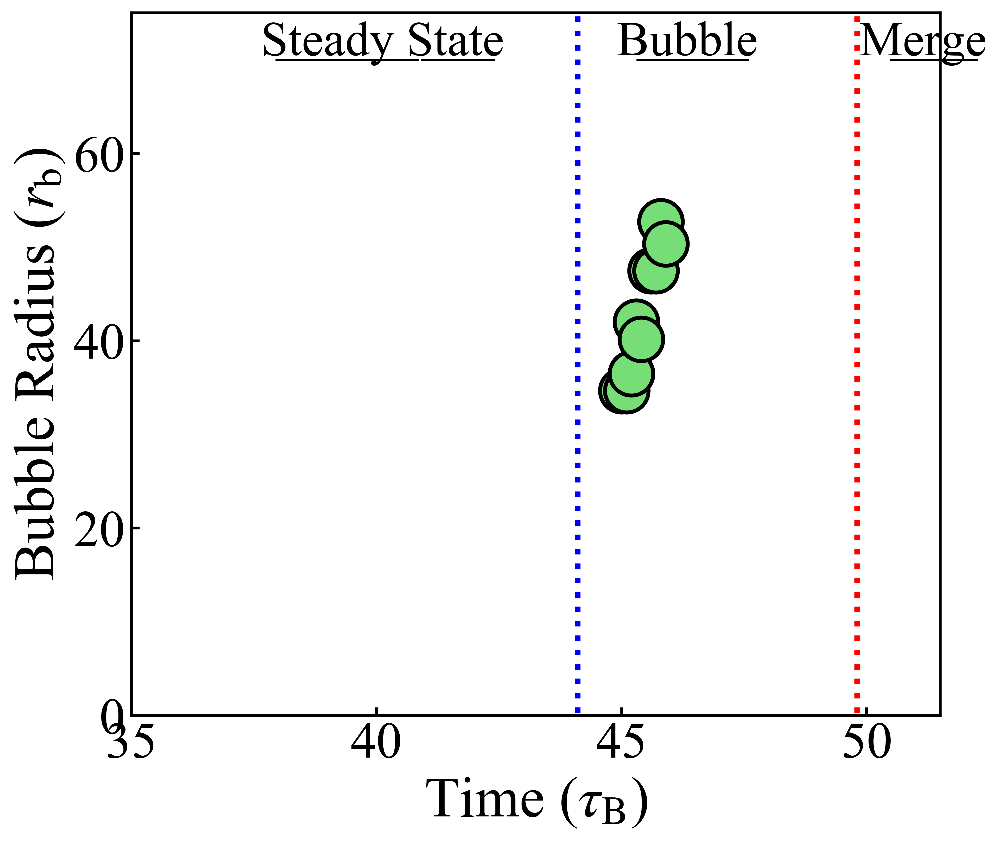

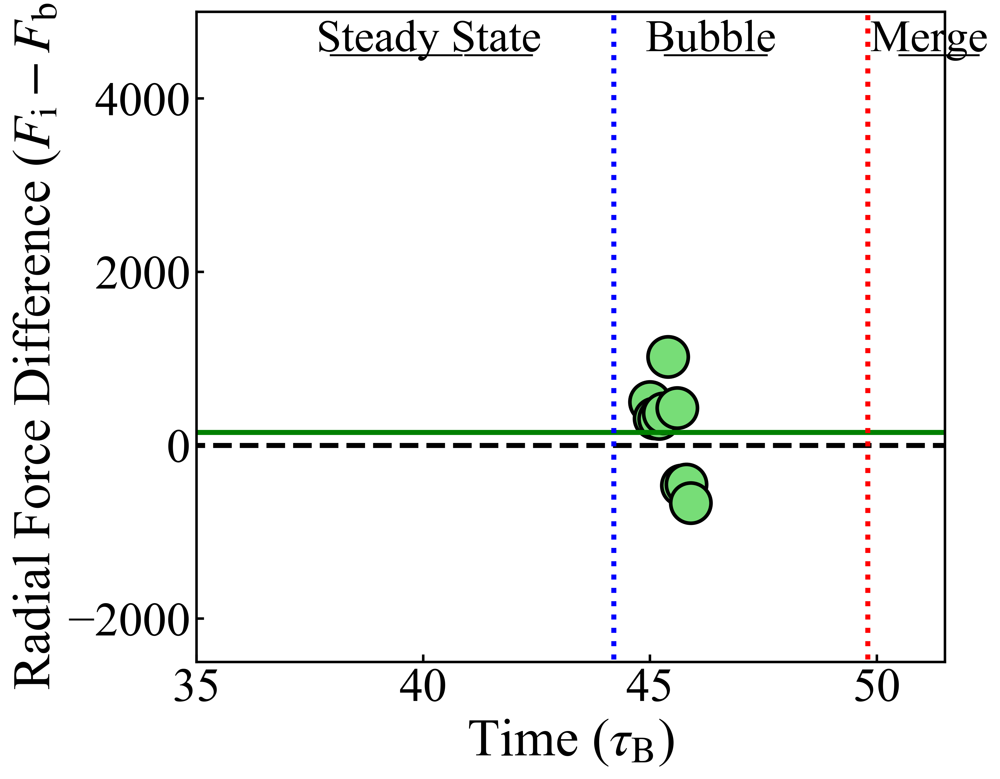

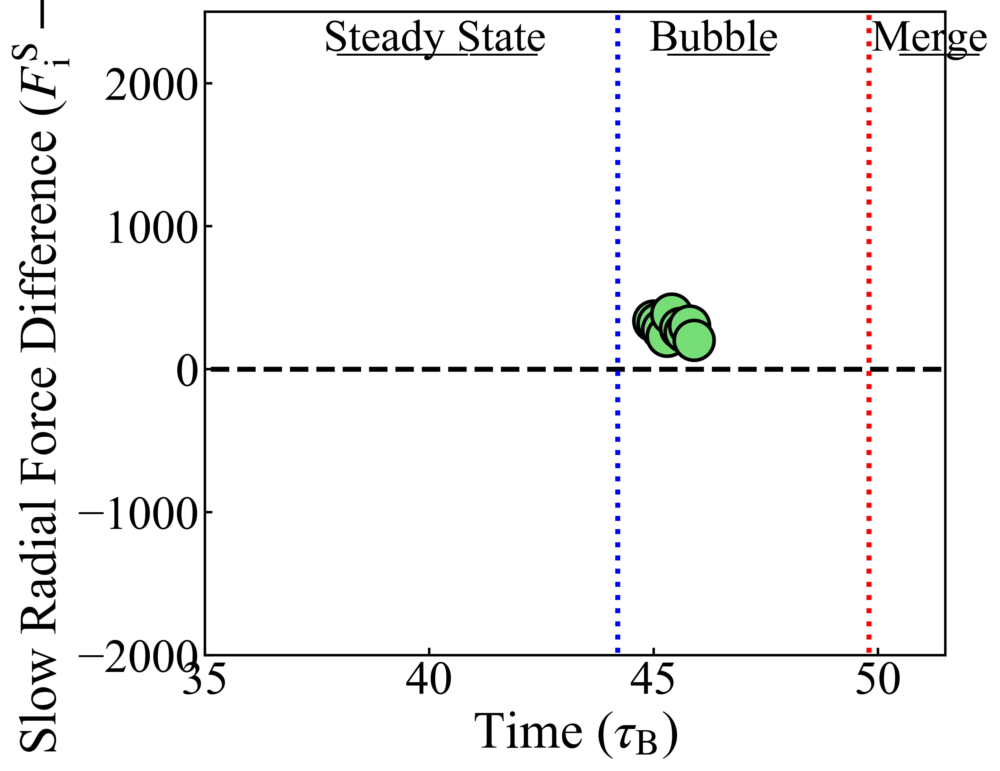

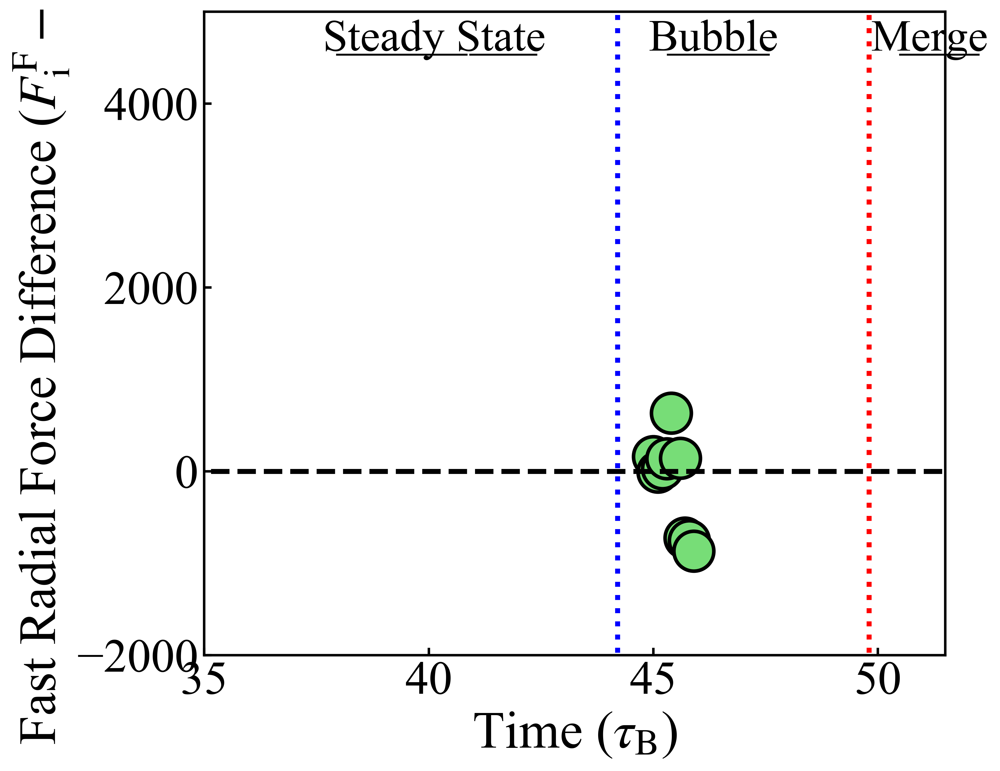

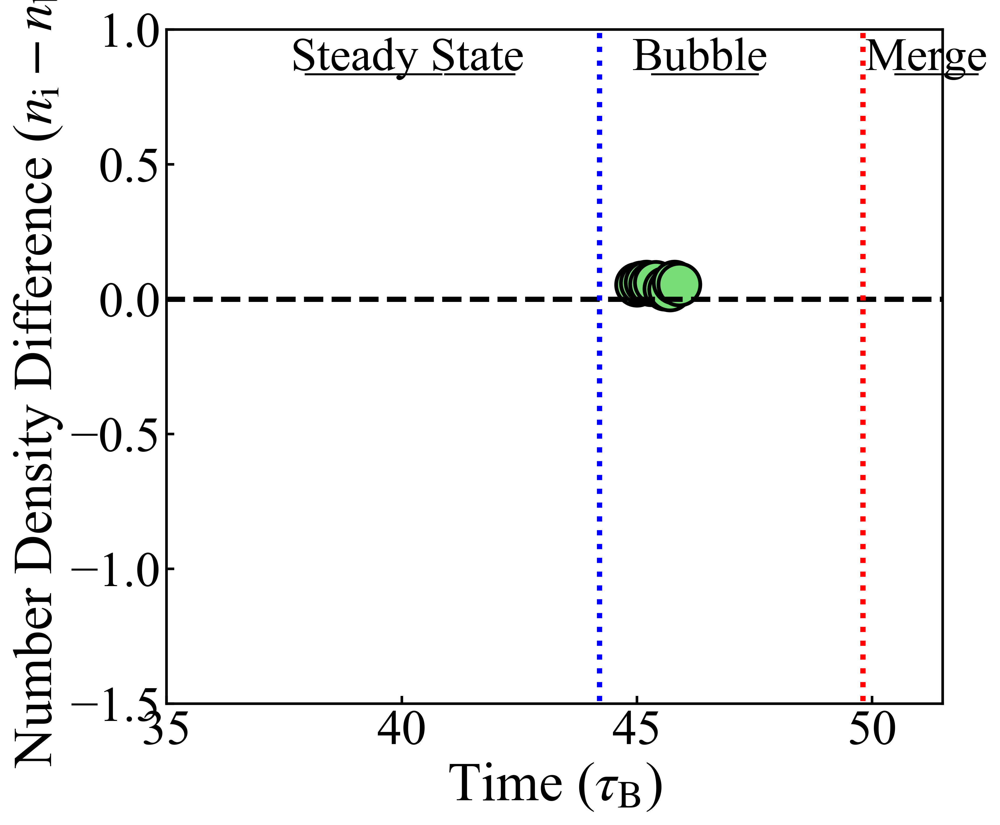

...

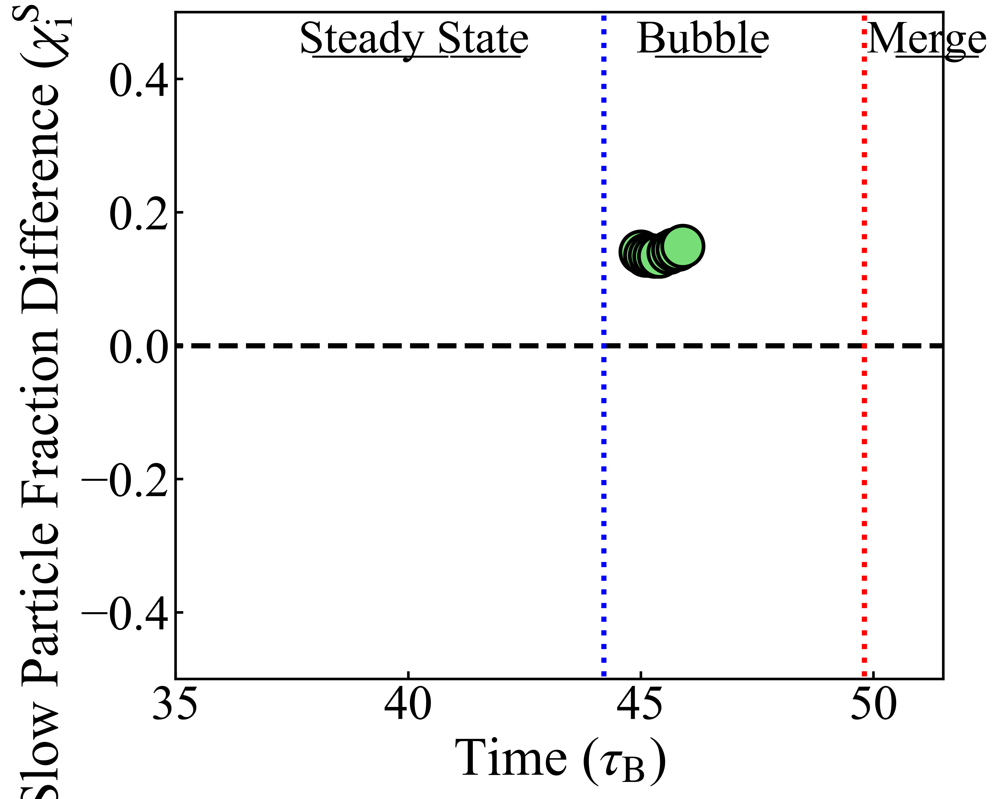

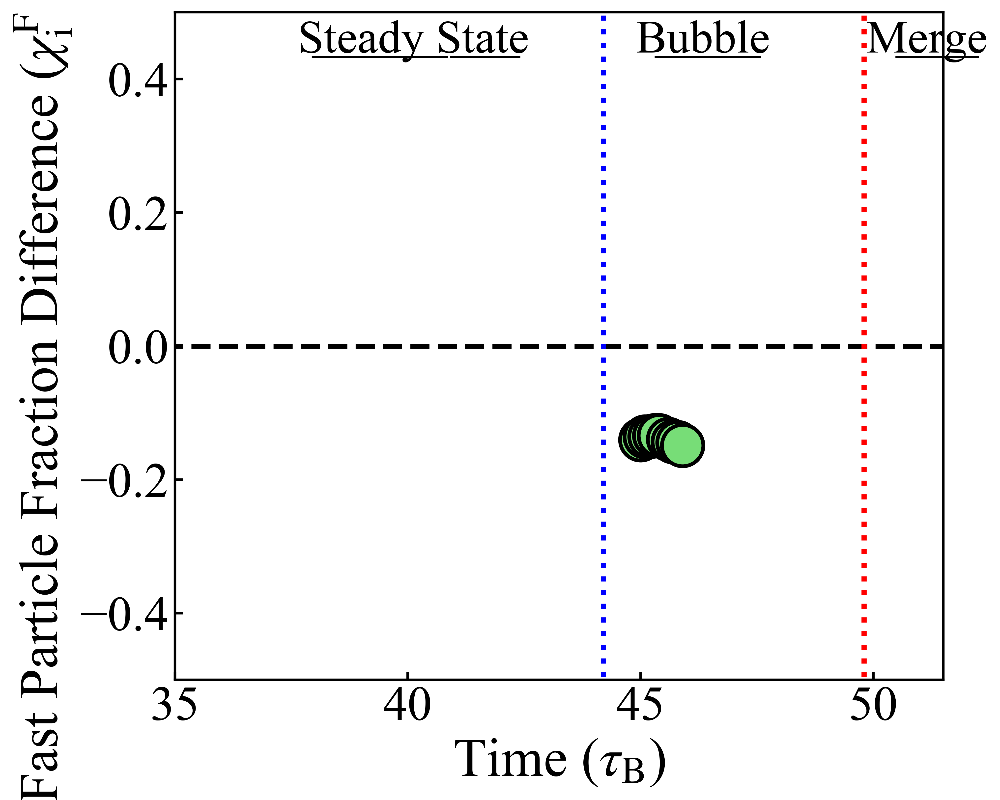

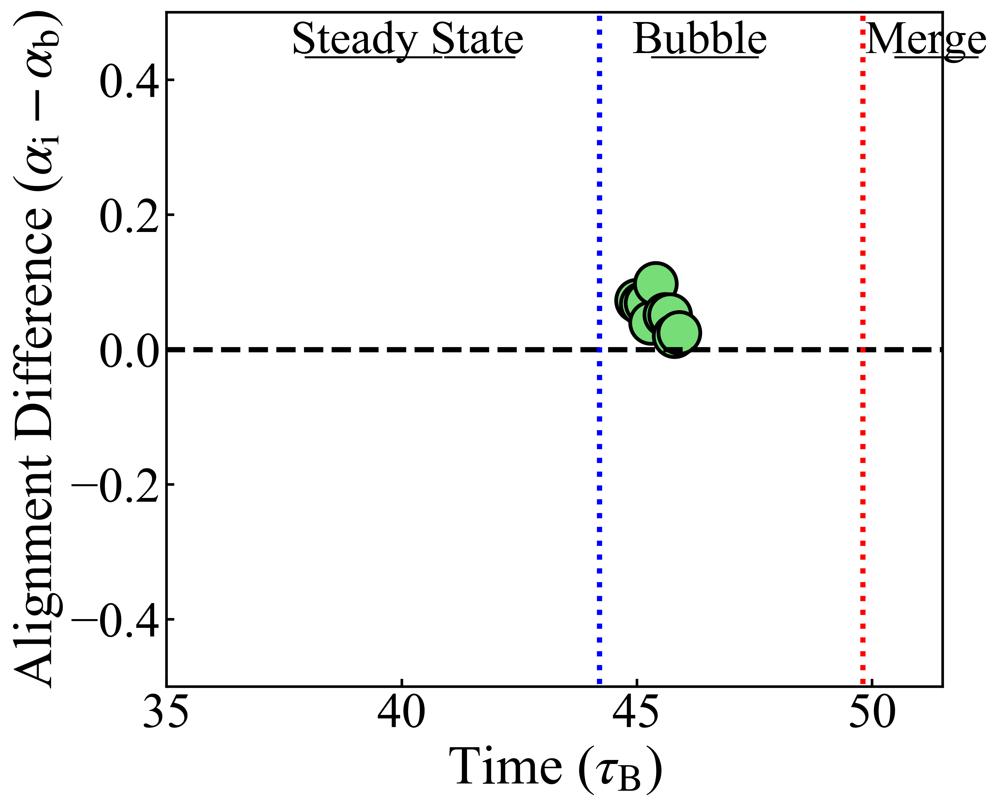

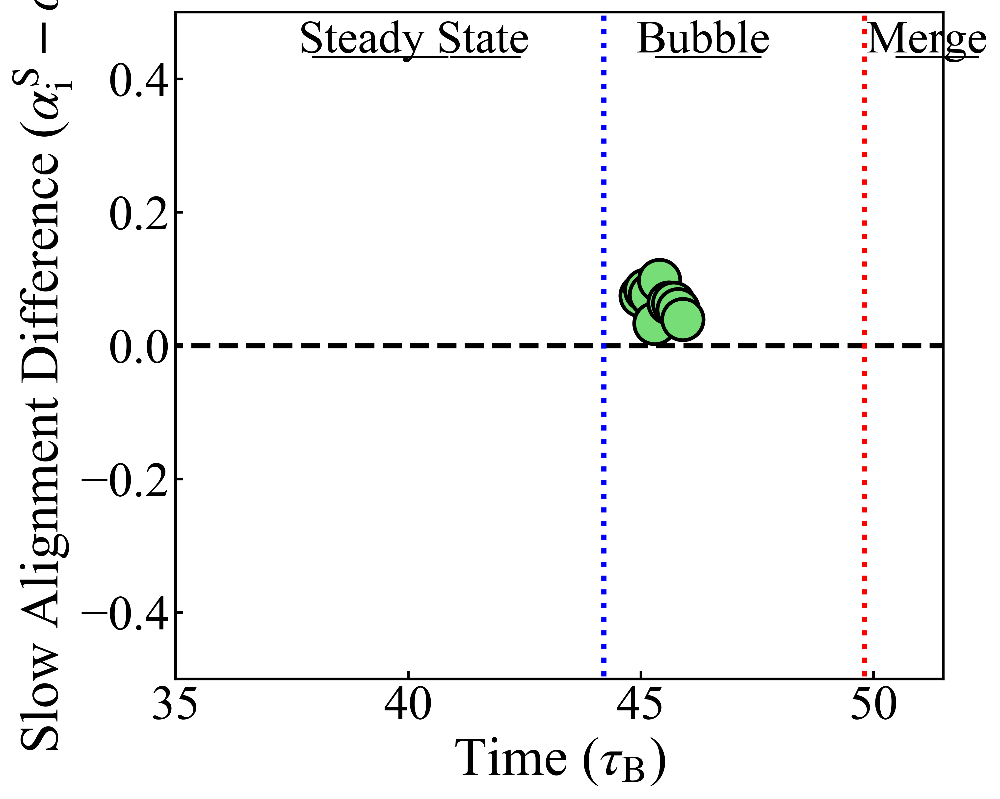

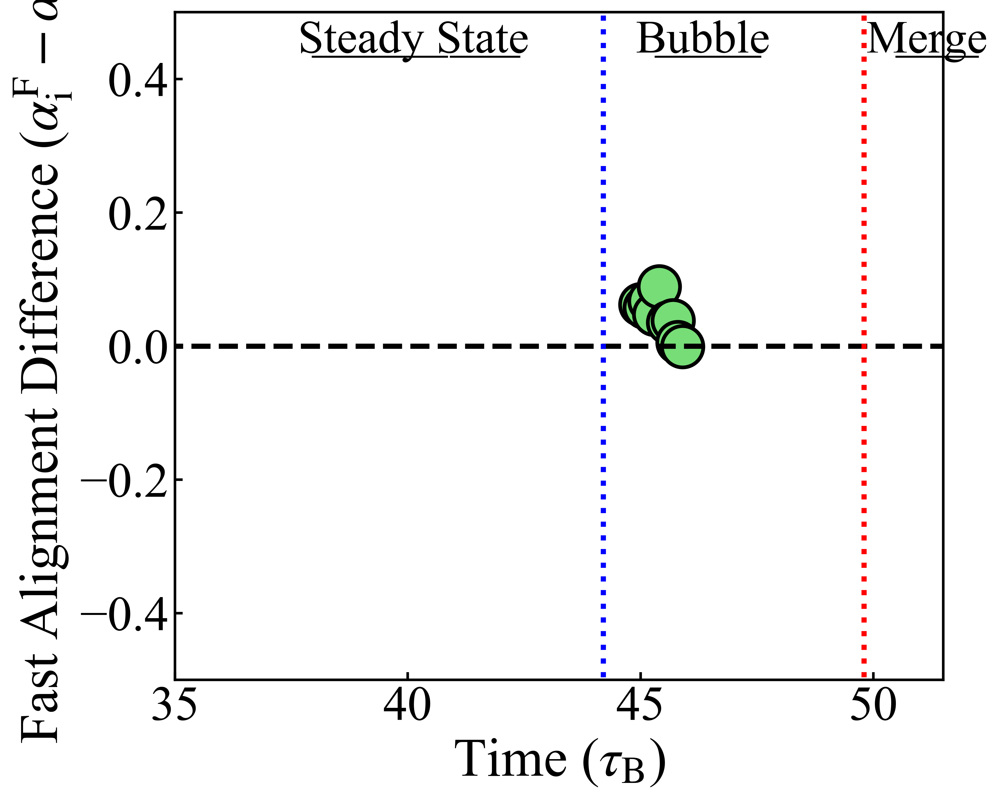

In [43]:
msz=15
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
green = ("#77dd77")
fsize=15

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]


fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], (bub_area_arr2[bub_time]/np.pi)**0.5, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr2 = np.array([44.1, 44.1])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)

x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([0, 75])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Bubble Radius ($r_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)



plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_fa_arr[bub_time]+bub_tot_fa_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)

int_time2 = np.where((int_time_arr>=45)& (int_time_arr<=49.8))[0]
bub_time2 = np.where((bub_time_arr>=45) & (bub_time_arr<=49.8))[0]
plt.plot(x_arr, [np.mean(int_tot_fa_arr[bub_time2]+bub_tot_fa_arr[bub_time2]), np.mean(int_tot_fa_arr[bub_time2]+bub_tot_fa_arr[bub_time2])], color='green', linewidth = 3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2500, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Radial Force Difference ($F_\mathrm{i}-F_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faA_arr[bub_time]+bub_tot_faA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 2500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Radial Force Difference ($F_\mathrm{i}^\mathrm{S}-F_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faB_arr[bub_time]+bub_tot_faB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Radial Force Difference ($F_\mathrm{i}^\mathrm{F}-F_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_dens_arr[bub_time]-bub_num_dens_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1.5, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Number Density Difference ($n_\mathrm{i}-n_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densA_arr[bub_time]-bub_num_densA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Number Density Difference ($n_\mathrm{i}^\mathrm{S}-n_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densB_arr[bub_time]-bub_num_densB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Number Density Difference ($n_\mathrm{i}^\mathrm{F}-n_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

non_time = np.where((bub_num_dens_arr[bub_time]>0))[0]
non_time2 = np.where((bub_num_dens_arr[bub_time]==0))[0]
fig, ax1 = plt.subplots(figsize=(8,7))

plt.scatter(bub_time_arr[bub_time][non_time], int_num_densA_arr[bub_time][non_time]/int_num_dens_arr[bub_time][non_time]-bub_num_densA_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densA_arr[bub_time][non_time2]/int_num_dens_arr[bub_time][non_time2]-int_num_densA_arr[bub_time][non_time2]/int_num_dens_arr[bub_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{S}-\chi_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time][non_time], int_num_densB_arr[bub_time][non_time]/int_num_dens_arr[bub_time][non_time]-bub_num_densB_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densB_arr[bub_time][non_time2]/int_num_dens_arr[bub_time][non_time2]-int_num_densB_arr[bub_time][non_time2]/int_num_dens_arr[bub_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{F}-\chi_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_align_arr[bub_time]+bub_align_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Alignment Difference ($\alpha_\mathrm{i}-\alpha_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignA_arr[bub_time]+bub_alignA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Alignment Difference ($\alpha_\mathrm{i}^\mathrm{S}-\alpha_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignB_arr[bub_time]+bub_alignB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Alignment Difference ($\alpha_\mathrm{i}^\mathrm{F}-\alpha_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


In [10]:
int_id_arr = np.array([])
current_id_arr = np.array([])
time_ids = np.array([])

int_area_arr = np.array([])
int_tot_fa_arr = np.array([])
int_tot_faA_arr = np.array([])
int_tot_faB_arr = np.array([])
int_align_arr = np.array([])
int_alignA_arr = np.array([])
int_alignB_arr = np.array([])
int_num_densB_arr = np.array([])
int_num_densA_arr = np.array([])
int_num_dens_arr = np.array([])
int_numB_arr = np.array([])
int_numA_arr = np.array([])
int_num_arr = np.array([])
int_com_x_arr = np.array([])
int_com_y_arr = np.array([])
int_time_arr = np.array([])

bub_area_arr = np.array([])
bub_tot_fa_arr = np.array([])
bub_tot_faA_arr = np.array([])
bub_tot_faB_arr = np.array([])
bub_align_arr = np.array([])
bub_alignA_arr = np.array([])
bub_alignB_arr = np.array([])
bub_num_densB_arr = np.array([])
bub_num_densA_arr = np.array([])
bub_num_dens_arr = np.array([])
bub_numB_arr = np.array([])
bub_numA_arr = np.array([])
bub_num_arr = np.array([])
bub_com_x_arr = np.array([])
bub_com_y_arr = np.array([])
bub_time_arr = np.array([])
                
for i in range(0, len(all_dens[0]['tauB'])):
    if all_dens[0]['tauB'][i] not in time_ids:
        loc = np.where(all_dens[0]['tauB']==all_dens[0]['tauB'][i])[0]
        if len(loc)>2:
            
            for j in loc:
                if all_dens[0]['current_id'][j] == all_dens[0]['int_id'][j]:
                    int_area_arr = np.append(int_area_arr, all_dens[0]['area'][j])
                    int_tot_fa_arr = np.append(int_tot_fa_arr, all_dens[0]['tot_fa'][j])
                    int_tot_faA_arr = np.append(int_tot_faA_arr, all_dens[0]['tot_faA'][j])
                    int_tot_faB_arr = np.append(int_tot_faB_arr, all_dens[0]['tot_faB'][j])
                    int_align_arr = np.append(int_align_arr, all_dens[0]['avg_align'][j])
                    int_alignA_arr = np.append(int_alignA_arr, all_dens[0]['avg_alignA'][j])
                    int_alignB_arr = np.append(int_alignB_arr, all_dens[0]['avg_alignB'][j])
                    int_num_densB_arr = np.append(int_num_densB_arr, all_dens[0]['avg_num_densB'][j])
                    int_num_densA_arr = np.append(int_num_densA_arr, all_dens[0]['avg_num_densA'][j])
                    int_num_dens_arr = np.append(int_num_dens_arr, all_dens[0]['avg_num_dens'][j])
                    int_numB_arr = np.append(int_numB_arr, all_dens[0]['numB'][j])
                    int_numA_arr = np.append(int_numA_arr, all_dens[0]['numA'][j])
                    int_num_arr = np.append(int_num_arr, all_dens[0]['num'][j])
                    int_com_x_arr = np.append(int_com_x_arr, all_dens[0]['com_x'][j])
                    int_com_y_arr = np.append(int_com_y_arr, all_dens[0]['com_y'][j])
                    int_time_arr = np.append(int_time_arr, all_dens[0]['tauB'][j])
                else:
                    test_id = np.where(all_dens[0]['tot_fa']==np.min(all_dens[0]['tot_fa'][loc]))
                    if j == test_id:
                        bub_area_arr = np.append(bub_area_arr, all_dens[0]['area'][j])
                        bub_tot_fa_arr = np.append(bub_tot_fa_arr, all_dens[0]['tot_fa'][j])
                        bub_tot_faA_arr = np.append(bub_tot_faA_arr, all_dens[0]['tot_faA'][j])
                        bub_tot_faB_arr = np.append(bub_tot_faB_arr, all_dens[0]['tot_faB'][j])
                        bub_align_arr = np.append(bub_align_arr, all_dens[0]['avg_align'][j])
                        bub_alignA_arr = np.append(bub_alignA_arr, all_dens[0]['avg_alignA'][j])
                        bub_alignB_arr = np.append(bub_alignB_arr, all_dens[0]['avg_alignB'][j])
                        bub_num_densB_arr = np.append(bub_num_densB_arr, all_dens[0]['avg_num_densB'][j])
                        bub_num_densA_arr = np.append(bub_num_densA_arr, all_dens[0]['avg_num_densA'][j])
                        bub_num_dens_arr = np.append(bub_num_dens_arr, all_dens[0]['avg_num_dens'][j])
                        bub_numB_arr = np.append(bub_numB_arr, all_dens[0]['numB'][j])
                        bub_numA_arr = np.append(bub_numA_arr, all_dens[0]['numA'][j])
                        bub_num_arr = np.append(bub_num_arr, all_dens[0]['num'][j])
                        bub_com_x_arr = np.append(bub_com_x_arr, all_dens[0]['com_x'][j])
                        bub_com_y_arr = np.append(bub_com_y_arr, all_dens[0]['com_y'][j])
                        bub_time_arr = np.append(bub_time_arr, all_dens[0]['tauB'][j])
        elif len(loc)==1:
            
            int_area_arr = np.append(int_area_arr, all_dens[0]['area'][i])
            int_tot_fa_arr = np.append(int_tot_fa_arr, all_dens[0]['tot_fa'][i])
            int_tot_faA_arr = np.append(int_tot_faA_arr, all_dens[0]['tot_faA'][i])
            int_tot_faB_arr = np.append(int_tot_faB_arr, all_dens[0]['tot_faB'][i])
            int_align_arr = np.append(int_align_arr, all_dens[0]['avg_align'][i])
            int_alignA_arr = np.append(int_alignA_arr, all_dens[0]['avg_alignA'][i])
            int_alignB_arr = np.append(int_alignB_arr, all_dens[0]['avg_alignB'][i])
            int_num_densB_arr = np.append(int_num_densB_arr, all_dens[0]['avg_num_densB'][i])
            int_num_densA_arr = np.append(int_num_densA_arr, all_dens[0]['avg_num_densA'][i])
            int_num_dens_arr = np.append(int_num_dens_arr, all_dens[0]['avg_num_dens'][i])
            int_numB_arr = np.append(int_numB_arr, all_dens[0]['numB'][i])
            int_numA_arr = np.append(int_numA_arr, all_dens[0]['numA'][i])
            int_num_arr = np.append(int_num_arr, all_dens[0]['num'][i])
            int_com_x_arr = np.append(int_com_x_arr, all_dens[0]['com_x'][i])
            int_com_y_arr = np.append(int_com_y_arr, all_dens[0]['com_y'][i])
            int_time_arr = np.append(int_time_arr, all_dens[0]['tauB'][i])
            bub_area_arr = np.append(bub_area_arr, 0)
            bub_tot_fa_arr = np.append(bub_tot_fa_arr, 0)
            bub_tot_faA_arr = np.append(bub_tot_faA_arr, 0)
            bub_tot_faB_arr = np.append(bub_tot_faB_arr, 0)
            bub_align_arr = np.append(bub_align_arr, 0)
            bub_alignA_arr = np.append(bub_alignA_arr, 0)
            bub_alignB_arr = np.append(bub_alignB_arr, 0)
            bub_num_densB_arr = np.append(bub_num_densB_arr, 0)
            bub_num_densA_arr = np.append(bub_num_densA_arr, 0)
            bub_num_dens_arr = np.append(bub_num_dens_arr, 0)
            bub_numB_arr = np.append(bub_numB_arr, 0)
            bub_numA_arr = np.append(bub_numA_arr, 0)
            bub_num_arr = np.append(bub_num_arr, 0)
            bub_com_x_arr = np.append(bub_com_x_arr, 0)
            bub_com_y_arr = np.append(bub_com_y_arr, 0)
            bub_time_arr = np.append(bub_time_arr, all_dens[0]['tauB'][i])
        elif len(loc)==2:
            
            for j in loc:
                if all_dens[0]['current_id'][j] == all_dens[0]['int_id'][j]:
                    
                    int_area_arr = np.append(int_area_arr, all_dens[0]['area'][j])
                    
                    int_tot_fa_arr = np.append(int_tot_fa_arr, all_dens[0]['tot_fa'][j])
                    int_tot_faA_arr = np.append(int_tot_faA_arr, all_dens[0]['tot_faA'][j])
                    int_tot_faB_arr = np.append(int_tot_faB_arr, all_dens[0]['tot_faB'][j])
                    int_align_arr = np.append(int_align_arr, all_dens[0]['avg_align'][j])
                    int_alignA_arr = np.append(int_alignA_arr, all_dens[0]['avg_alignA'][j])
                    int_alignB_arr = np.append(int_alignB_arr, all_dens[0]['avg_alignB'][j])
                    int_num_densB_arr = np.append(int_num_densB_arr, all_dens[0]['avg_num_densB'][j])
                    int_num_densA_arr = np.append(int_num_densA_arr, all_dens[0]['avg_num_densA'][j])
                    int_num_dens_arr = np.append(int_num_dens_arr, all_dens[0]['avg_num_dens'][j])
                    int_numB_arr = np.append(int_numB_arr, all_dens[0]['numB'][j])
                    int_numA_arr = np.append(int_numA_arr, all_dens[0]['numA'][j])
                    int_num_arr = np.append(int_num_arr, all_dens[0]['num'][j])
                    int_com_x_arr = np.append(int_com_x_arr, all_dens[0]['com_x'][j])
                    int_com_y_arr = np.append(int_com_y_arr, all_dens[0]['com_y'][j])
                    int_time_arr = np.append(int_time_arr, all_dens[0]['tauB'][j])
                else:
                    bub_area_arr = np.append(bub_area_arr, all_dens[0]['area'][j])
                    bub_tot_fa_arr = np.append(bub_tot_fa_arr, all_dens[0]['tot_fa'][j])
                    bub_tot_faA_arr = np.append(bub_tot_faA_arr, all_dens[0]['tot_faA'][j])
                    bub_tot_faB_arr = np.append(bub_tot_faB_arr, all_dens[0]['tot_faB'][j])
                    bub_align_arr = np.append(bub_align_arr, all_dens[0]['avg_align'][j])
                    bub_alignA_arr = np.append(bub_alignA_arr, all_dens[0]['avg_alignA'][j])
                    bub_alignB_arr = np.append(bub_alignB_arr, all_dens[0]['avg_alignB'][j])
                    bub_num_densB_arr = np.append(bub_num_densB_arr, all_dens[0]['avg_num_densB'][j])
                    bub_num_densA_arr = np.append(bub_num_densA_arr, all_dens[0]['avg_num_densA'][j])
                    bub_num_dens_arr = np.append(bub_num_dens_arr, all_dens[0]['avg_num_dens'][j])
                    bub_numB_arr = np.append(bub_numB_arr, all_dens[0]['numB'][j])
                    bub_numA_arr = np.append(bub_numA_arr, all_dens[0]['numA'][j])
                    bub_num_arr = np.append(bub_num_arr, all_dens[0]['num'][j])
                    bub_com_x_arr = np.append(bub_com_x_arr, all_dens[0]['com_x'][j])
                    bub_com_y_arr = np.append(bub_com_y_arr, all_dens[0]['com_y'][j])
                    bub_time_arr = np.append(bub_time_arr, all_dens[0]['tauB'][j])
            
            
        time_ids = np.append(time_ids, all_dens[0]['tauB'][i])

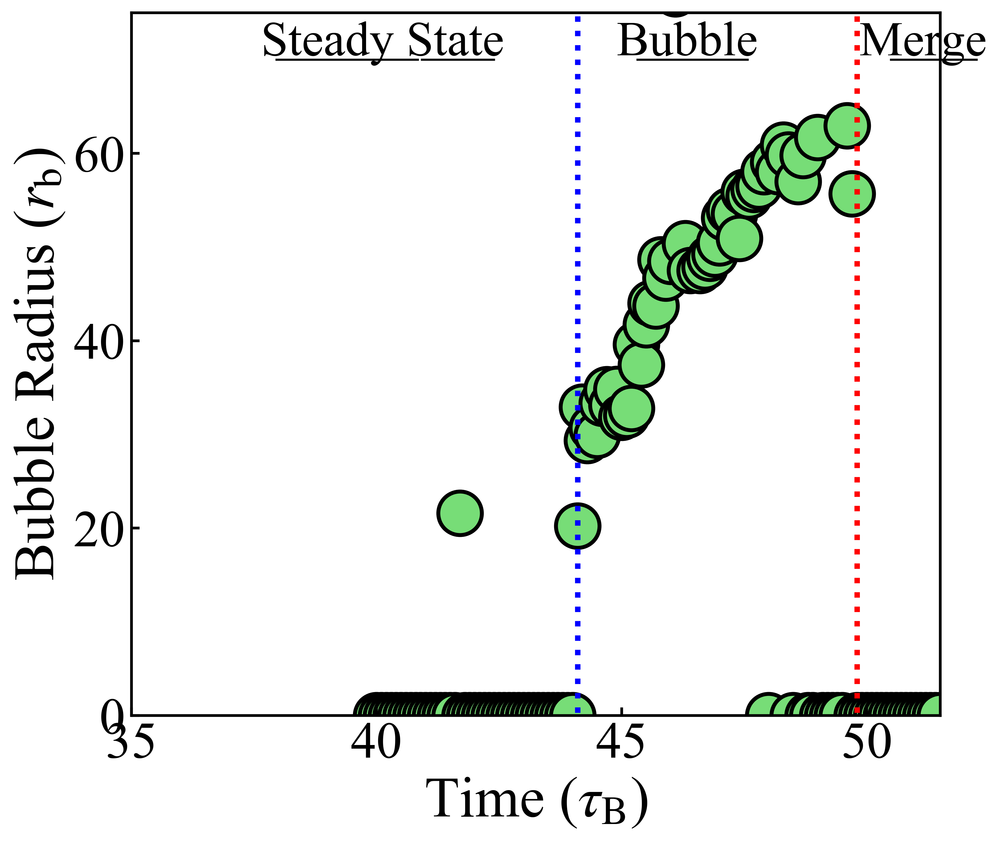

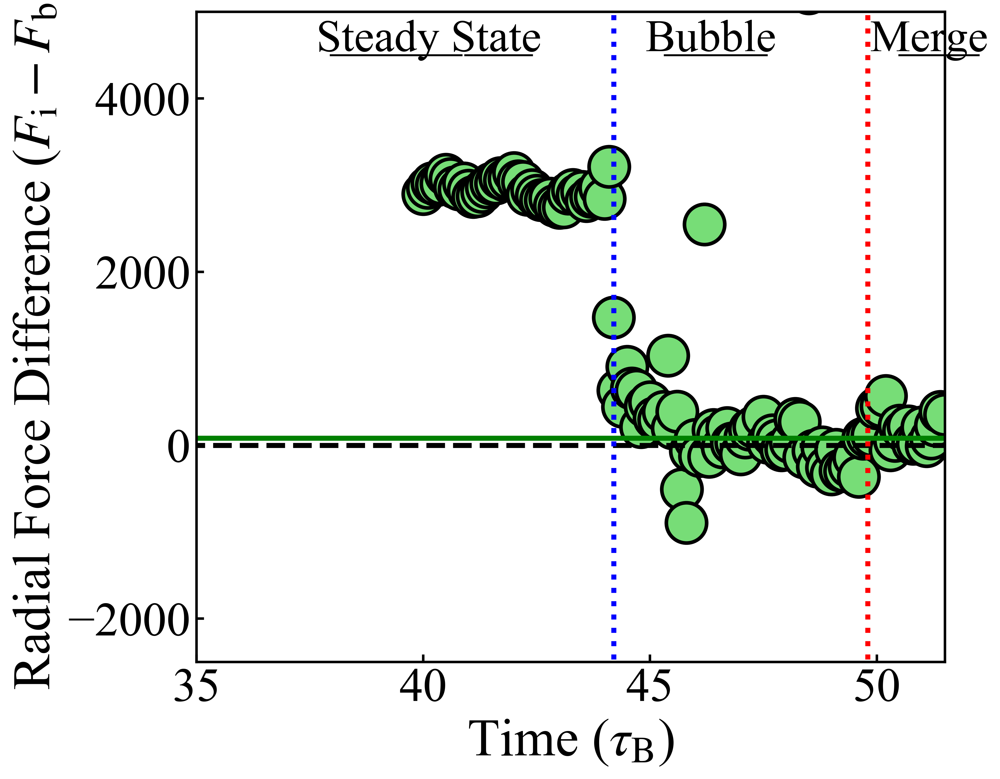

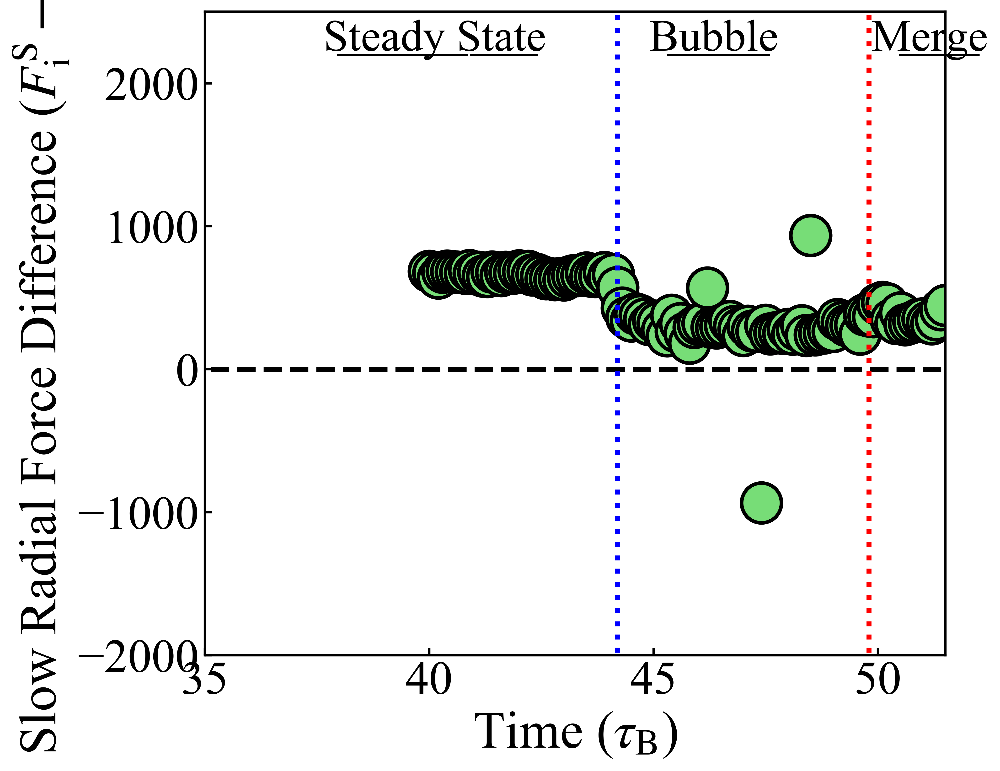

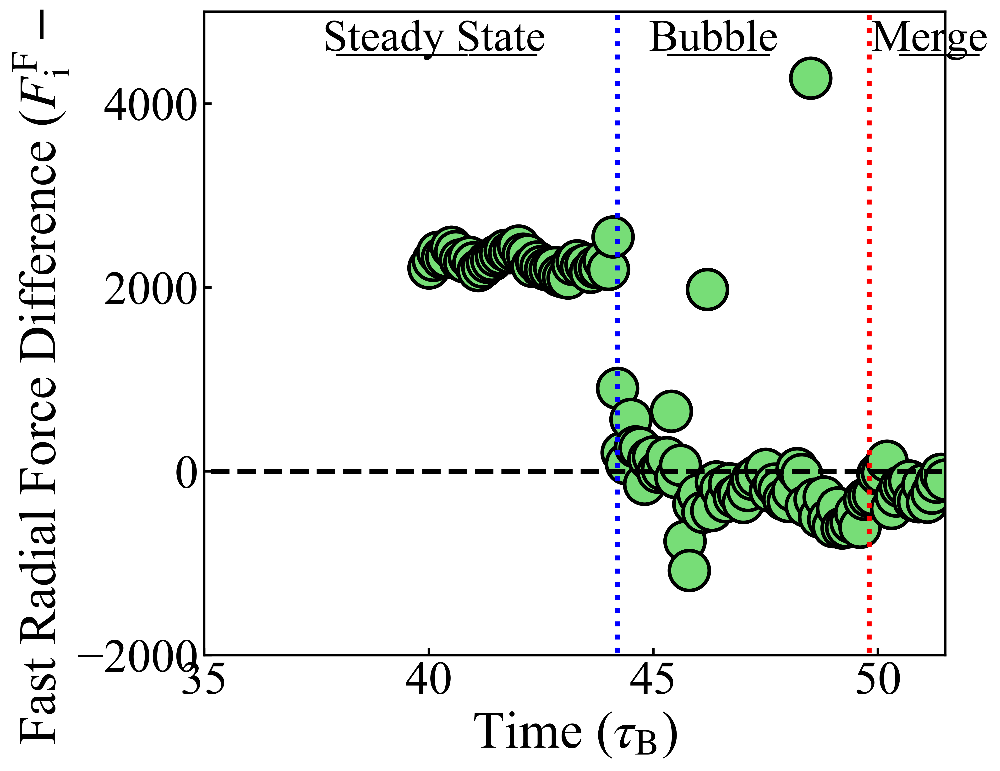

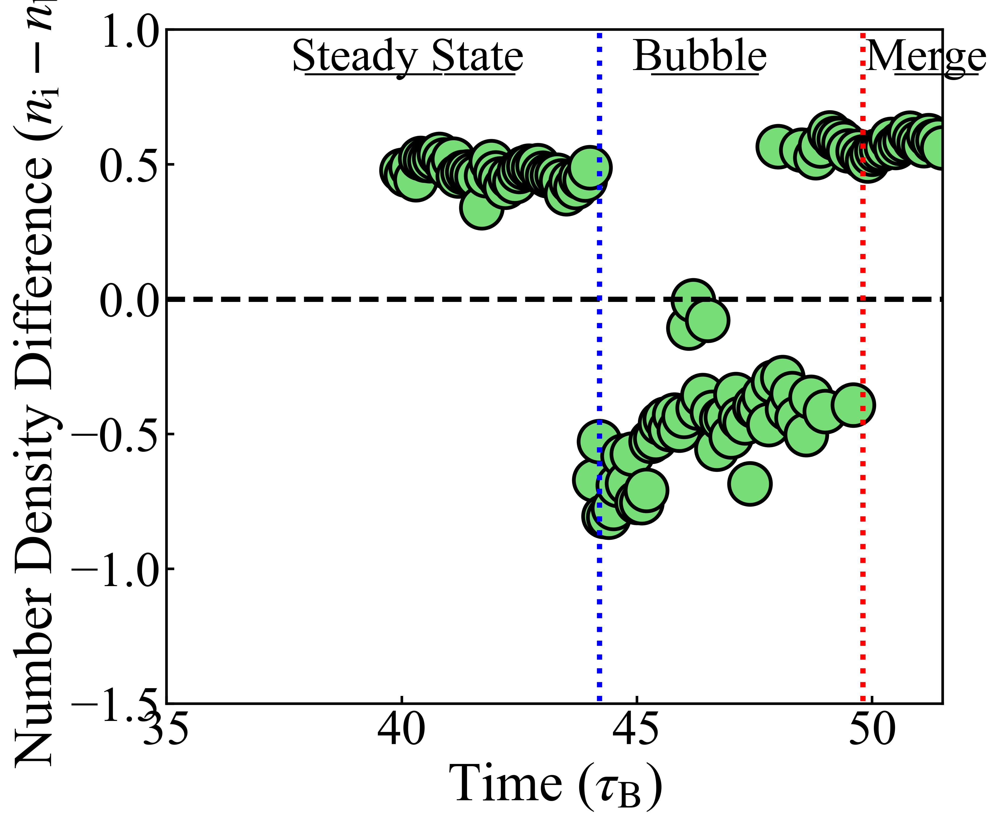

...

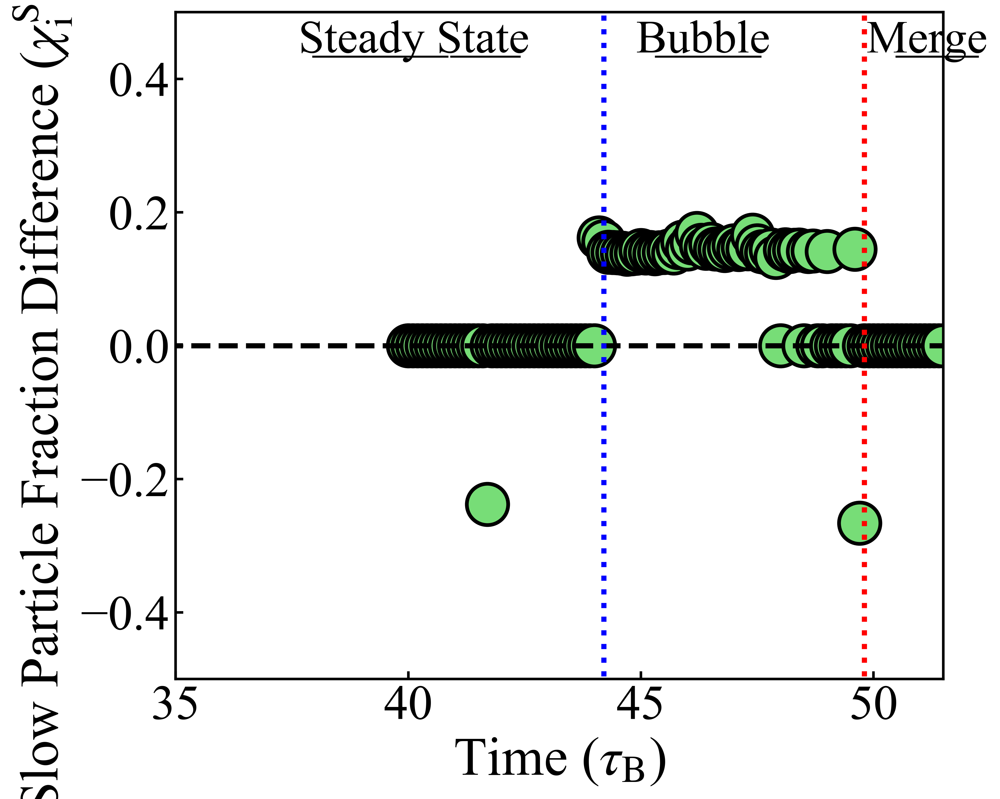

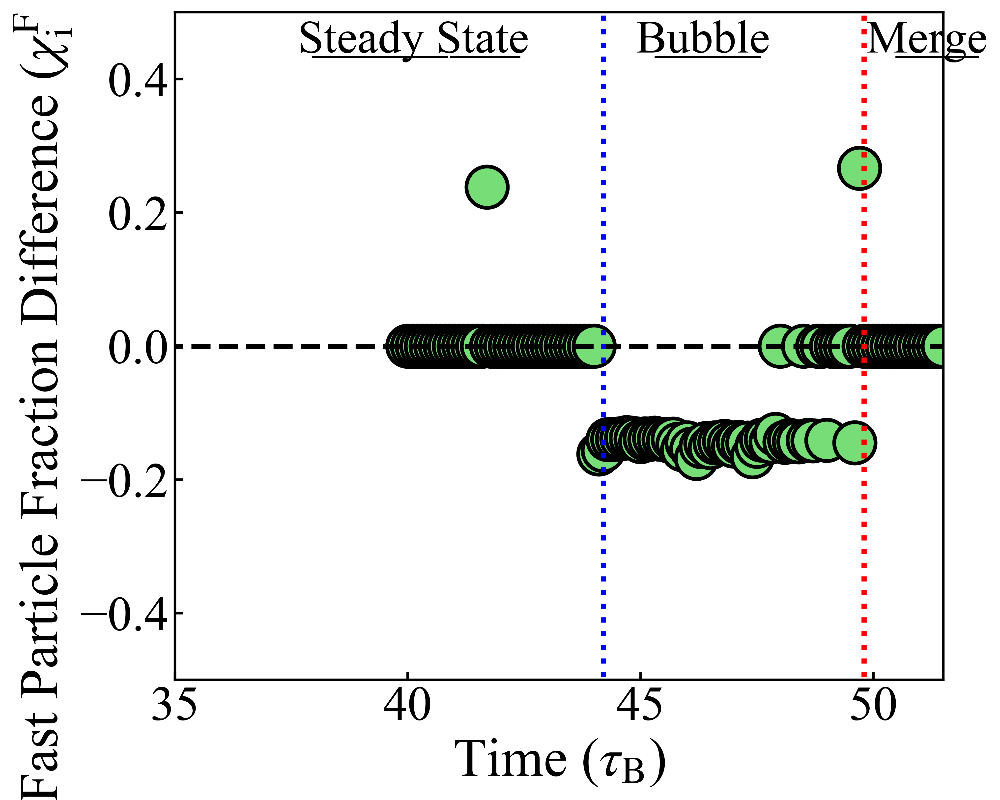

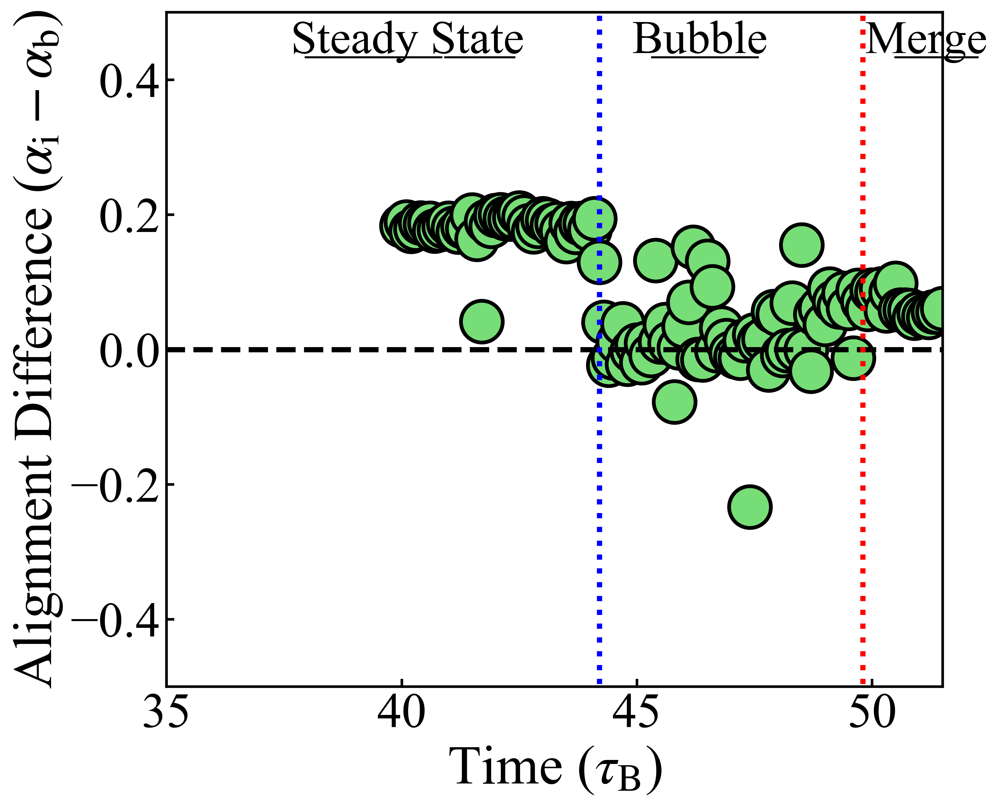

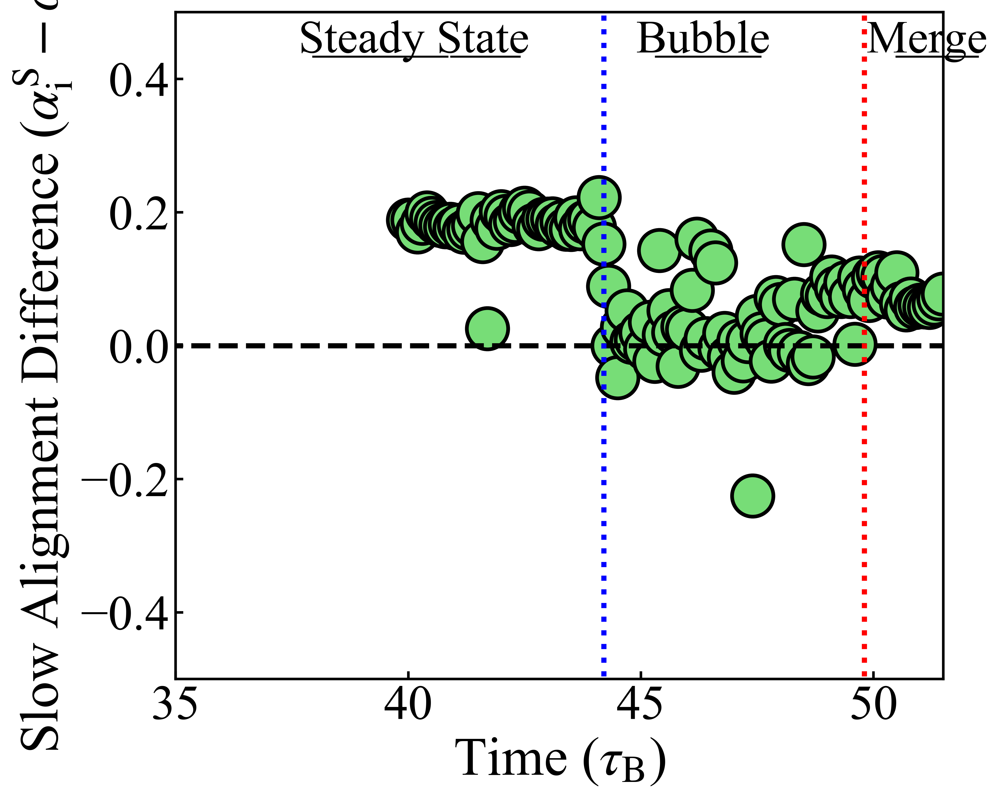

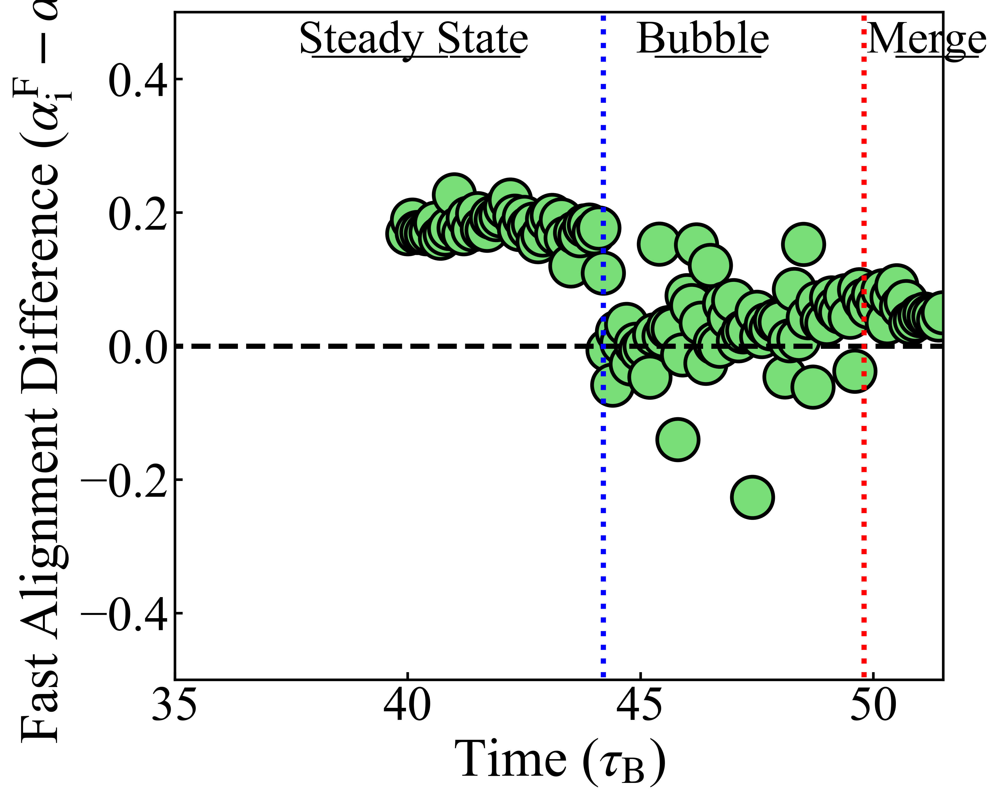

In [11]:
msz=15
mk='s'
med = 1.5
eps_leg=[]
mkSz = [0.8, 0.8]
green = ("#77dd77")
fsize=15

eps_leg.append(Line2D([0], [0], lw=0., marker='o', markeredgewidth=med,
                      markeredgecolor=green,
                      markerfacecolor=green,
                      label='Simulation', markersize=(2.4*msz * mkSz[0])))



int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]


fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], (bub_area_arr[bub_time]/np.pi)**0.5, edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr2 = np.array([44.1, 44.1])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)

x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([0, 75])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Bubble Radius ($r_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)



plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_fa_arr[int_time]+bub_tot_fa_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)

int_time2 = np.where((int_time_arr>=45)& (int_time_arr<=49.8))[0]
bub_time2 = np.where((bub_time_arr>=45) & (bub_time_arr<=49.8))[0]
plt.plot(x_arr, [np.mean(int_tot_fa_arr[int_time2]+bub_tot_fa_arr[bub_time2]), np.mean(int_tot_fa_arr[int_time2]+bub_tot_fa_arr[bub_time2])], color='green', linewidth = 3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2500, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Radial Force Difference ($F_\mathrm{i}-F_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faA_arr[int_time]+bub_tot_faA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 2500])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Radial Force Difference ($F_\mathrm{i}^\mathrm{S}-F_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()


int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_tot_faB_arr[int_time]+bub_tot_faB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-2000, 5000])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Radial Force Difference ($F_\mathrm{i}^\mathrm{F}-F_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

int_time = np.where((int_time_arr>=35)& (int_time_arr<=51.5))[0]
bub_time = np.where((bub_time_arr>=35) & (bub_time_arr<=51.5))[0]

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_dens_arr[int_time]-bub_num_dens_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1.5, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Number Density Difference ($n_\mathrm{i}-n_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densA_arr[int_time]-bub_num_densA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Number Density Difference ($n_\mathrm{i}^\mathrm{S}-n_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_num_densB_arr[int_time]-bub_num_densB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-1, 1])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Number Density Difference ($n_\mathrm{i}^\mathrm{F}-n_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

non_time = np.where((bub_num_dens_arr[bub_time]>0))[0]
non_time2 = np.where((bub_num_dens_arr[bub_time]==0))[0]
fig, ax1 = plt.subplots(figsize=(8,7))

plt.scatter(bub_time_arr[bub_time][non_time], int_num_densA_arr[int_time][non_time]/int_num_dens_arr[int_time][non_time]-bub_num_densA_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densA_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2]-int_num_densA_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')

x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{S}-\chi_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time][non_time], int_num_densB_arr[int_time][non_time]/int_num_dens_arr[int_time][non_time]-bub_num_densB_arr[bub_time][non_time]/bub_num_dens_arr[bub_time][non_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
plt.scatter(bub_time_arr[bub_time][non_time2], int_num_densB_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2]-int_num_densB_arr[int_time][non_time2]/int_num_dens_arr[int_time][non_time2], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Particle Fraction Difference ($\chi_\mathrm{i}^\mathrm{F}-\chi_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_align_arr[int_time]+bub_align_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Alignment Difference ($\alpha_\mathrm{i}-\alpha_\mathrm{b}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignA_arr[int_time]+bub_alignA_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Slow Alignment Difference ($\alpha_\mathrm{i}^\mathrm{S}-\alpha_\mathrm{b}^\mathrm{S}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()

fig, ax1 = plt.subplots(figsize=(8,7))
plt.scatter(bub_time_arr[bub_time], int_alignB_arr[int_time]+bub_alignB_arr[bub_time], edgecolor='black',facecolor=green,  linewidth = 1.8*1.2, s=msz*55*0.7, label='Dense Sim')
x_arr = np.array([0, 1000])
y_arr = np.array([0, 0])
plt.plot(x_arr, y_arr, linestyle='dashed', color='black', linewidth=3.0)
x_arr2 = np.array([44.2, 44.2])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='blue', linewidth=3.0)
x_arr2 = np.array([49.8, 49.8])
y_arr2 = np.array([-10000, 10000])
plt.plot(x_arr2, y_arr2, linestyle='dotted', color='red', linewidth=3.0)

ax1.set_xlim([35,51.5])
ax1.set_ylim([-0.5, 0.5])

ax1.tick_params(axis='x', labelsize=fsize*1.9)
ax1.tick_params(axis='y', labelsize=fsize*1.9)
ax1.set_ylabel(r'Fast Alignment Difference ($\alpha_\mathrm{i}^\mathrm{F}-\alpha_\mathrm{b}^\mathrm{F}$)', fontsize=fsize*2.1)
ax1.set_xlabel(r'Time ($\tau_\mathrm{B}$)', fontsize=fsize*2.1)
ax1.text(0.16, 0.94, s='\u0332'.join('Steady State'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.6, 0.94, s='\u0332'.join('Bubble'), fontsize=fsize*1.8, transform=ax1.transAxes)
ax1.text(0.9, 0.94, s='\u0332'.join('Merge'), fontsize=fsize*1.8, transform=ax1.transAxes)




plt.show()
